# Exploratory Data Analysis

#### Here we are having a look for trends and patterns within the data, as well as cleaning it up and feature engineering where necessary.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
pd.set_option('display.max_columns', 2000)

### Cleaning

#### Here we are going through, examining the data and cleaning it.

In [3]:
#loading in the dataframe
df = pd.read_csv(r'final_df.csv',low_memory=False)
df.head()

matchId             createdAt  duration  \
0  7373654d-5bc9-4ce4-92e3-963377f9b079  2021-04-08T00:15:57Z      1754   
1  d0311463-0dd6-4561-acc5-d00f6c5eaf4a  2021-04-18T03:03:35Z      1728   
2  0a2c4387-392b-4d5e-86cf-c836ac589921  2021-04-17T02:05:03Z      1943   
3  58943bf7-3a97-444a-8f78-3fb3768bcc8e  2021-04-12T16:09:30Z      1836   
4  dcd9dc35-3656-4c00-b134-73c382ba82cf  2021-04-17T04:26:09Z      1677   

  gameMode  isCustomMatch         mapName matchType seasonState  shardId  \
0     solo          False     Baltic_Main  official    progress  console   
1     solo          False     Baltic_Main  official    progress  console   
2     solo          False     Baltic_Main  official    progress  console   
3     solo          False     Baltic_Main  official    progress  console   
4     solo          False  DihorOtok_Main  official    progress  console   

   stats  tags        titleId  \
0    NaN   NaN  bluehole-pubg   
1    NaN   NaN  bluehole-pubg   
2    NaN   NaN  bluehole-pubg   
3    NaN   NaN  bluehole-pubg   
4    NaN   NaN  bluehole-pubg   

                                       telemetry_url  P_1_DBNOs  P_1_assists  \
0  https://telemetry-cdn.pubg.com/bluehole-pubg/c...          0            0   
1  https://telemetry-cdn.pubg.com/bluehole-pubg/c...          0            0   
2  https://telemetry-cdn.pubg.com/bluehole-pubg/c...          0            0   
3  https://telemetry-cdn.pubg.com/bluehole-pubg/c...          0            0   
4  https://telemetry-cdn.pubg.com/bluehole-pubg/c...          0            0   

   P_1_boosts  P_1_damageDealt P_1_deathType  P_1_headshotKills  P_1_heals  \
0          12        786.93050         alive                  2          3   
1           4        538.64124         alive                  1          6   
2           0        463.15286         alive                  0          2   
3          12        682.55054         alive                  2          5   
4           7        906.94250         alive                  5          1   

   P_1_killPlace  P_1_killStreaks  P_1_kills  P_1_longestKill  \
0              2                1          7         81.72769   
1              3                1          5         68.06080   
2              4                1          4         45.59808   
3              1                1         10        134.39485   
4              1                2         11        462.47110   

          P_1_name                              P_1_playerId  P_1_revives  \
0  Abstinent Panda  account.d25a7c228fb94024813f909f4892ba4f            0   
1  VenenoAntrax497  account.1e75f3cdd1684905957224371da8e366            0   
2    Oiled Up Seal  account.1203161302454f5fa60629295373a071            0   
3    Strait RAMBIS  account.024e1230efcd41c496b70de755903d41            0   
4            MKG44  account.c425843fcb434eaeacae563728954204            0   

   P_1_rideDistance  P_1_roadKills  P_1_swimDistance  P_1_teamKills  \
0         3344.5322              0               0.0              0   
1         3945.0688              0               0.0              0   
2         3815.3706              0               0.0              0   
3         6518.2007              0               0.0              0   
4         2071.3396              0               0.0              0   

   P_1_timeSurvived  P_1_vehicleDestroys  P_1_walkDistance  \
0          1754.210                    0         2720.6200   
1          1728.896                    0         1626.3755   
2          1943.255                    0         2727.4707   
3          1836.460                    0         1982.3655   
4          1677.571                    0         3534.6553   

   P_1_weaponsAcquired  P_1_winPlace P_1_gaming_system  P_2_DBNOs  \
0                   10             1              xbox          0   
1                    4             1              xbox          0   
2                    6             1              xbox          0   
3                    6             1         

In [4]:
#looking at the shape
df.shape

(18985, 2088)

In [5]:
#Some columns have no info in them, or repeat info which we already have in other columns. We can remove these.
#start by removing columns where all the values are NaN (removed 16 columns.)
df.dropna(axis=1, how='all', inplace=True)

In [7]:
df.head(2)

matchId             createdAt  duration  \
0  7373654d-5bc9-4ce4-92e3-963377f9b079  2021-04-08T00:15:57Z      1754   
1  d0311463-0dd6-4561-acc5-d00f6c5eaf4a  2021-04-18T03:03:35Z      1728   

  gameMode  isCustomMatch      mapName matchType seasonState  shardId  \
0     solo          False  Baltic_Main  official    progress  console   
1     solo          False  Baltic_Main  official    progress  console   

         titleId                                      telemetry_url  \
0  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
1  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   

   P_1_DBNOs  P_1_assists  P_1_boosts  P_1_damageDealt P_1_deathType  \
0          0            0          12        786.93050         alive   
1          0            0           4        538.64124         alive   

   P_1_headshotKills  P_1_heals  P_1_killPlace  P_1_killStreaks  P_1_kills  \
0                  2          3              2                1          7   
1                  1          6              3                1          5   

   P_1_longestKill         P_1_name                              P_1_playerId  \
0         81.72769  Abstinent Panda  account.d25a7c228fb94024813f909f4892ba4f   
1         68.06080  VenenoAntrax497  account.1e75f3cdd1684905957224371da8e366   

   P_1_revives  P_1_rideDistance  P_1_roadKills  P_1_swimDistance  \
0            0         3344.5322              0               0.0   
1            0         3945.0688              0               0.0   

   P_1_teamKills  P_1_timeSurvived  P_1_vehicleDestroys  P_1_walkDistance  \
0              0          1754.210                    0         2720.6200   
1              0          1728.896                    0         1626.3755   

   P_1_weaponsAcquired  P_1_winPlace P_1_gaming_system  P_2_DBNOs  \
0                   10             1              xbox          0   
1                    4             1              xbox          0   

   P_2_assists  P_2_boosts  P_2_damageDealt P_2_deathType  P_2_headshotKills  \
0            0           5        573.27734      byplayer                  0   
1            0           9        894.47455      byplayer                  0   

   P_2_heals  P_2_killPlace  P_2_killStreaks  P_2_kills  P_2_longestKill  \
0          6              4                1          4        111.95494   
1          7              2                1          6        138.41516   

       P_2_name                              P_2_playerId  P_2_revives  \
0  BeardedVoice  account.ac032d51cd9c47b482dadf4858b7686a            0   
1  ChevyShepard  account.de67e12c5eb545eeb96e12f6d5e2a9d0            0   

   P_2_rideDistance  P_2_roadKills  P_2_swimDistance  P_2_teamKills  \
0         5748.0938              0               0.0              0   
1         4997.0835              0               0.0              0   

   P_2_timeSurvived  P_2_vehicleDestroys  P_2_walkDistance  \
0          1746.146                    0         2874.5710   
1          1720.829                    1         2553.3054   

   P_2_weaponsAcquired  P_2_winPlace P_2_gaming_system  P_3_DBNOs  \
0                    8             2              xbox          0   
1                    6             2              xbox          0   

   P_3_assists  P_3_boosts  P_3_damageDealt P_3_deathType  P_3_headshotKills  \
0            0           7        265.27274      byplayer                  1   
1            0           7         96.22019      byplayer                  0   

   P_3_heals  P_3_killPlace  P_3_killStreaks  P_3_kills  P_3_longestKill  \
0          1              5                1          4         47.50157   
1          0             16                1          2        196.35507   

        P_3_name                              P_3_playerId  P_3_revives  \
0     Blazeboy86  account.c342c360c6bb4756bd8e930be503a201            0   
1  Wolverine2889  account.0e2c95b916fc454fb53cf602da1a020c            0   

   P_3_rideDistance  P_3_roadK

In [8]:
#next I want to look at how many unique values in each column, if there is only ever 1 value, I may want to drop it.
cols_with_1_unique = []
for i in df.columns:
    if df[i].nunique() < 2:
        cols_with_1_unique.append(i)
len(cols_with_1_unique)

153

In [9]:
#having a look at the columns with 1 value.
cols_with_1_unique

['gameMode',
 'isCustomMatch',
 'matchType',
 'seasonState',
 'shardId',
 'titleId',
 'P_1_DBNOs',
 'P_1_assists',
 'P_1_revives',
 'P_1_teamKills',
 'P_1_winPlace',
 'P_2_DBNOs',
 'P_2_assists',
 'P_2_revives',
 'P_2_teamKills',
 'P_3_DBNOs',
 'P_3_assists',
 'P_3_revives',
 'P_3_teamKills',
 'P_mid_DBNOs',
 'P_mid_assists',
 'P_mid_revives',
 'P_mid_teamKills',
 'P_mid2_DBNOs',
 'P_mid2_assists',
 'P_mid2_revives',
 'P_mid2_teamKills',
 'P_last_but10_DBNOs',
 'P_last_but10_assists',
 'P_last_but10_revives',
 'P_last_but10_teamKills',
 'P_last_DBNOs',
 'P_last_assists',
 'P_last_headshotKills',
 'P_last_revives',
 'P_last_roadKills',
 'P_last_teamKills',
 'K_1_DBNOs',
 'K_1_assists',
 'K_1_killPlace',
 'K_1_revives',
 'K_1_teamKills',
 'K_2_DBNOs',
 'K_2_assists',
 'K_2_killPlace',
 'K_2_revives',
 'K_2_teamKills',
 'K_3_DBNOs',
 'K_3_assists',
 'K_3_killPlace',
 'K_3_revives',
 'K_3_teamKills',
 'GS_0.1_poisonGasWarningPosition',
 'GS_0.1_poisonGasWarningRadius',
 'death#24_finishDam

In [10]:
#there's a lot of columns with just one value...
#some of these I want to keep in as checks. gameMode, isCustomMatch, matchType and seasonState for example. I'll remove those from this list now.
cols_to_keep = ['gameMode','isCustomMatch','matchType','seasonState', 'shardId']
cols_with_1_unique = [x for x in cols_with_1_unique if x not in cols_to_keep]

#others will have '0' values because they don't apply to this game state. Those can go next.
cols_with_1_unique_of_0 = []
cols_with_1_unique_not_0 = []
for i in cols_with_1_unique:
    if df[i].unique()[0] == 0:
        cols_with_1_unique_of_0.append(i)
    else:
        cols_with_1_unique_not_0.append(i)
        
print(len(cols_with_1_unique_of_0))
print(len(cols_with_1_unique_not_0))

43
105


In [11]:
#lets have a look at what's left of these. I can remove the DBNO,assist,revives and teamkill columns as they don't apply to the gamemode.
display(cols_with_1_unique_of_0)
#updating cols to keep to include these
cols_to_keep = cols_to_keep + [x for x in [x for x in [x for x in [x for x in cols_with_1_unique_of_0 if 'revives' not in x] if 'assists' not in x] if 'teamKills' not in x] if 'DBNOs' not in x]

['P_1_DBNOs',
 'P_1_assists',
 'P_1_revives',
 'P_1_teamKills',
 'P_2_DBNOs',
 'P_2_assists',
 'P_2_revives',
 'P_2_teamKills',
 'P_3_DBNOs',
 'P_3_assists',
 'P_3_revives',
 'P_3_teamKills',
 'P_mid_DBNOs',
 'P_mid_assists',
 'P_mid_revives',
 'P_mid_teamKills',
 'P_mid2_DBNOs',
 'P_mid2_assists',
 'P_mid2_revives',
 'P_mid2_teamKills',
 'P_last_but10_DBNOs',
 'P_last_but10_assists',
 'P_last_but10_revives',
 'P_last_but10_teamKills',
 'P_last_DBNOs',
 'P_last_assists',
 'P_last_headshotKills',
 'P_last_revives',
 'P_last_roadKills',
 'P_last_teamKills',
 'K_1_DBNOs',
 'K_1_assists',
 'K_1_revives',
 'K_1_teamKills',
 'K_2_DBNOs',
 'K_2_assists',
 'K_2_revives',
 'K_2_teamKills',
 'K_3_DBNOs',
 'K_3_assists',
 'K_3_revives',
 'K_3_teamKills',
 'GS_0.1_poisonGasWarningRadius']

In [12]:
#so far, from the columns with 1 unique value, these are the columns I'm chosing to keep. Next I will look at those 1 unique value that isn't 0.
cols_to_keep

['gameMode',
 'isCustomMatch',
 'matchType',
 'seasonState',
 'shardId',
 'P_last_headshotKills',
 'P_last_roadKills',
 'GS_0.1_poisonGasWarningRadius']

In [13]:
cols_with_1_unique_not_0

['titleId',
 'P_1_winPlace',
 'K_1_killPlace',
 'K_2_killPlace',
 'K_3_killPlace',
 'GS_0.1_poisonGasWarningPosition',
 'death#24_finishDamageInfo_damageReason_',
 'death#25_finishDamageInfo_damageReason_',
 'death#26_finishDamageInfo_damageReason_',
 'death#27_finishDamageInfo_damageReason_',
 'death#30_finishDamageInfo_damageReason_',
 'death#31_finishDamageInfo_damageReason_',
 'death#32_finishDamageInfo_damageReason_',
 'death#34_finishDamageInfo_damageReason_',
 'death#35_finishDamageInfo_damageReason_',
 'death#36_finishDamageInfo_damageReason_',
 'death#38_finishDamageInfo_damageReason_',
 'death#39_finishDamageInfo_damageReason_',
 'death#40_finishDamageInfo_damageReason_',
 'death#41_finishDamageInfo_damageReason_',
 'death#43_finishDamageInfo_damageReason_',
 'death#44_finishDamageInfo_damageReason_',
 'death#45_finishDamageInfo_damageReason_',
 'death#46_finishDamageInfo_damageReason_',
 'death#47_finishDamageInfo_damageReason_',
 'death#48_finishDamageInfo_damageReason_',
 

In [14]:
#looking up the unique values for this.
df['death#85_finishDamageInfo_damageReason_'].unique()

array([nan, 'SimulateAIBeKilled'], dtype=object)

In [15]:
df[df['death#85_finishDamageInfo_damageReason_'] == 'SimulateAIBeKilled'][[x for x in df.columns if 'death#85' in x]].head(2)

,death#85_finishDamageInfo_damageReason_,death#85_victim_accountId,death#85_victim_location,death#85_victim_ranking,death#85_finisher_accountId,death#85_finisher_location,death#85_finisher_health,death#85_finisher_ranking,death#85_finishDamageInfo_damageReason,death#85_finishDamageInfo_damageTypeCategory,death#85_finishDamageInfo_damageCauserName,death#85_finishDamageInfo_distance,death#85_isSuicide_,death#85_common_,death#85__D_
4,SimulateAIBeKilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,SimulateAIBeKilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
#all the "death#82_finishDamageInfo_damageReason_" style columns are an error of the data mining. I want the value of these columns
#to be in the corresponding "death#82_finishDamageInfo_damageReason" column. Lets address that and remove those excess columns.
#sometimes in the game, AI (bots) are randomly removed. When this has happened, it's left a lot of columns blank. We can fill those here to protect future analysis.

for i in range(100):
    try:
        search_term = 'death#' + str(i) + '_finishDamageInfo_damageReason'
        search_term2 = 'death#' + str(i) + '_'
        df[search_term].fillna(df[search_term+'_'],inplace=True)
        df[search_term2+'finishDamageInfo_damageTypeCategory'].fillna(df[search_term+'_'],inplace=True)
        df[search_term2+'finishDamageInfo_damageCauserName'].fillna(df[search_term+'_'],inplace=True)
        del df[search_term+'_']
    except:
        try:
            del df[search_term+'_']
            pass
        except:
            pass
        
[x for x in cols_with_1_unique_not_0 if '_finishDamageInfo_damageReason_' not in x]

['titleId',
 'P_1_winPlace',
 'K_1_killPlace',
 'K_2_killPlace',
 'K_3_killPlace',
 'GS_0.1_poisonGasWarningPosition',
 'death#99_victim_ranking',
 'death#99_finisher_health',
 'death#99_finishDamageInfo_distance',
 'P_mid_GS_5_location',
 'P_mid_GS_5.5_location',
 'P_mid_GS_6_location',
 'P_last_GS_5.5_location',
 'P_last_GS_6_location',
 'P_mid2_GS_8.5_location',
 'P_last_but10_GS_5.5_location',
 'P_last_but10_GS_6_location']

In [18]:
#looking at what is left with the unique cols, I'm happy to keep these as checks (for example P_1_winPlace should always be 1, 
#but P_2/P_3_winPlace should always be 2/3, but isn't on account of some errors in the data files. The GS_##_location columns
#are there because it's very unusual for a last but 10/mid range player to reach this game stage, but not impossible, so I want to keep those too.

cols_to_keep = cols_to_keep + [x for x in cols_with_1_unique_not_0 if '_finishDamageInfo_damageReason_' not in x]

In [19]:
cols_to_remove = [x for x in [x for x in cols_with_1_unique if x not in cols_to_keep] if '_finishDamageInfo_damageReason_' not in x]

In [20]:
for i in cols_to_remove:
    del df[i]

In [21]:
#having a look at the shape since clearing it up.
df.shape

(18985, 1957)

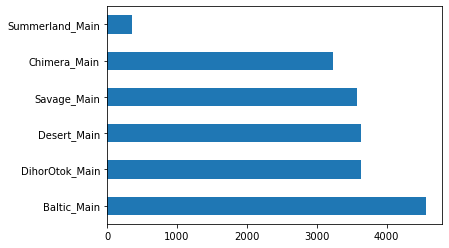

In [22]:
#plot showing different map types across matches. It's important because some maps have max 100 players, others max 64. Maps are also
#different sizes.
df.mapName.value_counts().plot(kind='barh');

In [23]:
df['mapName'].unique()

array(['Baltic_Main', 'DihorOtok_Main', 'Desert_Main', 'Savage_Main',
       'Chimera_Main', 'Summerland_Main'], dtype=object)

In [24]:
df[(df['mapName'] != 'Summerland_Main')]

matchId             createdAt  duration  \
0      7373654d-5bc9-4ce4-92e3-963377f9b079  2021-04-08T00:15:57Z      1754   
1      d0311463-0dd6-4561-acc5-d00f6c5eaf4a  2021-04-18T03:03:35Z      1728   
2      0a2c4387-392b-4d5e-86cf-c836ac589921  2021-04-17T02:05:03Z      1943   
3      58943bf7-3a97-444a-8f78-3fb3768bcc8e  2021-04-12T16:09:30Z      1836   
4      dcd9dc35-3656-4c00-b134-73c382ba82cf  2021-04-17T04:26:09Z      1677   
...                                     ...                   ...       ...   
18980  01c6952c-d98a-4daf-a798-42d61e16dea5  2021-04-16T20:27:57Z      1855   
18981  577966c2-8265-451a-a337-faba54e86a5b  2021-04-17T12:31:07Z      1672   
18982  771999f8-4a7f-4e70-ae5f-ddd0da22f2c6  2021-04-10T10:31:00Z      1915   
18983  9869fa00-4203-4af8-854c-492e99efb2e2  2021-04-13T16:09:48Z      1727   
18984  3211152e-0061-4375-aa25-2e07fdd7f804  2021-04-16T12:04:45Z      1976   

      gameMode  isCustomMatch         mapName matchType seasonState  shardId  \
0         solo          False     Baltic_Main  official    progress  console   
1         solo          False     Baltic_Main  official    progress  console   
2         solo          False     Baltic_Main  official    progress  console   
3         solo          False     Baltic_Main  official    progress  console   
4         solo          False  DihorOtok_Main  official    progress  console   
...        ...            ...             ...       ...         ...      ...   
18980     solo          False     Desert_Main  official    progress  console   
18981     solo          False  DihorOtok_Main  official    progress  console   
18982     solo          False     Desert_Main  official    progress  console   
18983     solo          False  DihorOtok_Main  official    progress  console   
18984     solo          False     Desert_Main  official    progress  console   

             titleId                                      telemetry_url  \
0      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
1      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
2      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
3      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
4      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
...              ...                                                ...   
18980  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18981  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18982  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18983  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18984  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   

       P_1_boosts  P_1_damageDealt P_1_deathType  P_1_headshotKills  \
0              12        786.93050         alive                  2   
1               4        538.64124         alive                  1   
2               0        463.15286         alive                  0   
3              12        682.55054         alive                  2   
4               7        906.94250         alive                  5   
...           ...              ...           ...                ...   
18980           6        583.26920         alive                  3   
18981           8       1317.36740         alive                  4   
18982          15       1283.16850         alive                  1   
18983           7        497.06842         alive                  0   
18984           8        808.59690         alive                  4   

       P_1_heals  P_1_killPlace  P_1_killStreaks  P_1_kills  P_1_longestKill  \
0              3              2                1          7        81.727690   
1              6              3                1          5        68.060800   
2              2              4                1          4        45.598080   
3              5              1                1    

In [25]:
#making a new dataframe which only has 100 player maps.
df_100_player_maps = df[(df['mapName'] == 'Baltic_Main') | (df['mapName'] ==  'DihorOtok_Main')| (df['mapName'] ==  'Desert_Main')| (df['mapName'] ==  'Savage_Main')]

In [26]:
#making a dataframe showing cause of death
death_damage_cat = pd.concat([df_100_player_maps[x].value_counts() for x in df_100_player_maps.columns if 'geInfo_damageTypeCategory' in x],axis=1)

In [27]:
#compiling a list of column names for plotting purposes, with deaths in order.
finish_cat_list = []
for i in range(100):
    search_term = 'death#' + str(i) + '_finishDamageInfo_damageTypeCategory'
    finish_cat_list.append(search_term)
finish_cat_list.reverse()

In [28]:
death_damage_cat = death_damage_cat.loc[:,finish_cat_list].T

In [29]:
death_damage_cat.shape

(100, 22)

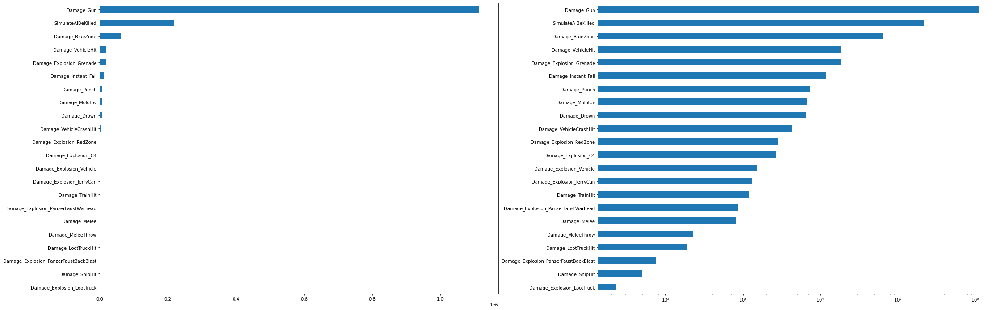

In [222]:
#a look at overall kill methods. Unsurpsingly a gun is the most common, followed by 'SimulateAiBeKilled', which is the random removal of 'ai' or bots from the game.
fig, ax = plt.subplots(ncols=2,figsize=(36,12))
plt.subplots_adjust(wspace = 0.25)
death_damage_cat.sum().sort_values().plot(kind='barh', ax=ax[1])
death_damage_cat.sum().sort_values().plot(kind='barh', ax=ax[0])
ax[1].set_xscale('log')
plt.show();

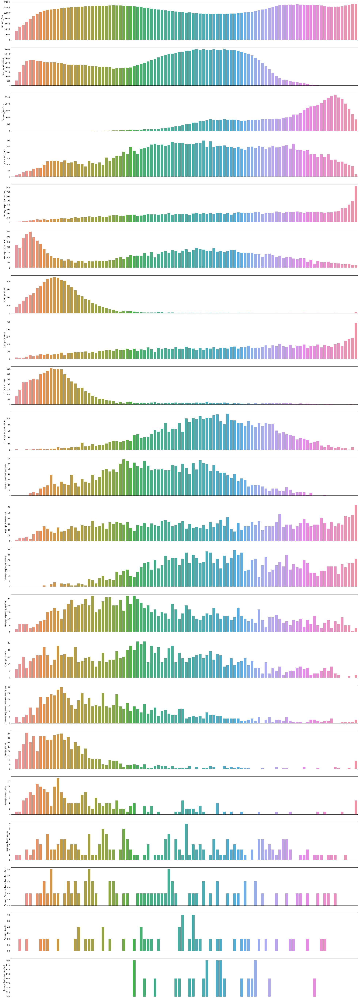

In [31]:
#This is a more indepth look at what causes players to die. When factoring in the AI removal midway through the game, it looks like gun deaths are fairly consistent. 
#A players chance of dying to the bluezone increases asthe match goes on. As the game progresses, the bluezone does more damage, so this makes sense.
#Deaths from vehicle hits are low at the start (players usual prioritise landing and searching for guns in buildings) and increase as the game goes and players are forced to move.
# as the game proceeds and the player zone gets smaller, a player is less likely to need a vehicle (as they need to cover less distance) and the opportunities to run players over are likely to diminish.
# Grenade and molotov kills follow a similiar trend, creeping up slightly as the game progresses. It could be that as the game goes on and the play zone shrinks, players are forced closer together and more likely to be within grenade/molotov range
# There is a large disparity when looking at the deaths caused by falling - right at the start of the game you parachute in, it can be easy to clip a tree and fall to your death.
# The punch deaths are very much an early game feature, as players struggle to find a weapon and are forced into hand to hand combat.
# drowning also features heavily early game; quite often this is caused by players quiting a match before it's started, being kicked out of the plane and landing in water.

plt.figure(figsize=(34,100))
for num, i in enumerate(death_damage_cat.sum().sort_values(ascending=False).index):
    plt.subplot(22,1,num+1)
    sns.barplot(x=death_damage_cat.index, y=i, data=death_damage_cat,orient='v')
    plt.xticks([])

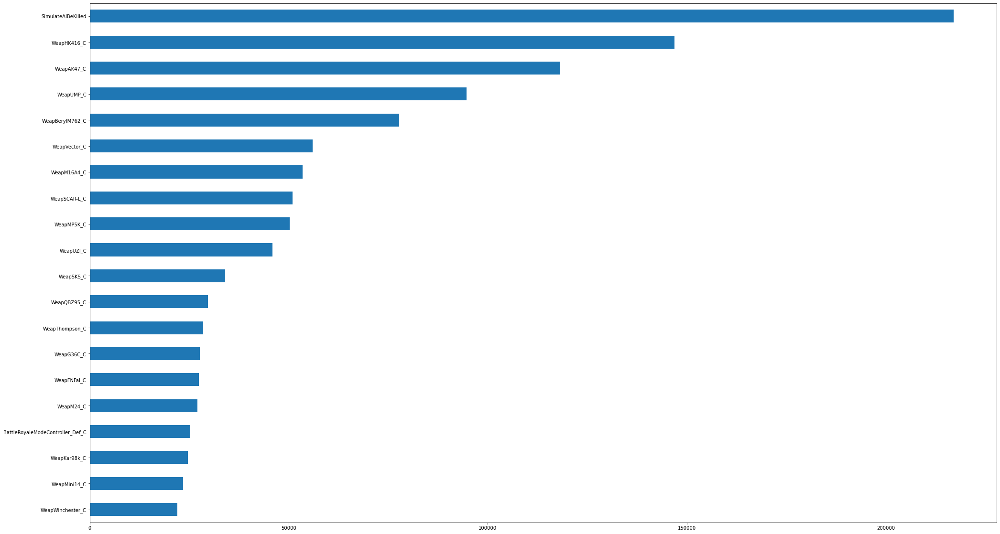

In [220]:
#here we are looking at use of different weapons. Since there are a lot of different weapons, here we're only looking at the top 20.
death_damage_weapon = pd.concat([df_100_player_maps[x].value_counts() for x in df_100_player_maps.columns if '_finishDamageInfo_damageCauserName' in x],axis=1)

finish_wep_list = []
for i in range(100):
    search_term = 'death#' + str(i) + '_finishDamageInfo_damageCauserName'
    finish_wep_list.append(search_term)
finish_wep_list.reverse()
    
death_damage_weapon = death_damage_weapon.loc[:,finish_wep_list].T

death_damage_weapon.sum().sort_values(ascending=False)[:20].sort_values(ascending=True).plot(kind='barh',figsize = (34, 20))
plt.show();

In [219]:
death_damage_weapon

,WeapHK416_C,WeapBerylM762_C,WeapUMP_C,WeapAK47_C,WeapMP5K_C,ProjGrenade_C,WeapVector_C,WeapGroza_C,WeapSCAR-L_C,WeapAUG_C,WeapQBZ95_C,WeapMk14_C,BattleRoyaleModeController_Def_C,WeapSKS_C,WeapFNFal_C,WeapG36C_C,WeapThompson_C,WeapAWM_C,WeapBizonPP19_C,BattleRoyaleModeController_Desert_C,WeapUZI_C,WeapM24_C,WeapM16A4_C,BP_MolotovFireDebuff_C,WeapKar98k_C,WeapMini14_C,BattleRoyaleModeController_DihorOtok_C,WeapMG3_C,WeapMk47Mutant_C,BattleRoyaleModeController_Savage_C,WeapM249_C,WeapVSS_C,WeapMosinNagant_C,WeapQBU88_C,WeapDP12_C,ProjC4_C,BP_FireEffectController_C,WeapWinchester_C,WeapDP28_C,Weapvz61Skorpion_C,WeapSaiga12_C,PlayerFemale_A_C,PlayerMale_A_C,WeapG18_C,WeapM1911_C,WeapCrossbow_1_C,WeapBerreta686_C,WeapWin94_C,WeapLunchmeatsAK47_C,WeapDuncansHK416_C,WeapPan_C,WeapM9_C,BP_BRDM_C,WeapPanProjectile_C,WeapSawnoff_C,PanzerFaust100M_Projectile_C,BP_JerryCanFireDebuff_C,BP_CoupeRB_C,WeapMadsQBU88_C,WeapDesertEagle_C,WeapNagantM1895_C,None,BP_Dirtbike_C,ProjMolotov_C,Dacia_A_01_v2_C,BP_DO_Line_Train_Merged_C,BP_DO_Circle_Train_Merged_C,WeapMacheteProjectile_C,BP_Niva_04_C,BP_PickupTruck_A_05_C,Dacia_A_03_v2_C,WeapRhino_C,Buggy_A_03_C,Buggy_A_02_C,Uaz_C_01_C,BP_Niva_05_C,Uaz_B_01_C,BP_Motorglider_C,BP_Niva_06_C,BP_Motorbike_04_C,Dacia_A_04_v2_C,Buggy_A_01_C,BP_Niva_07_C,BP_Motorbike_04_SideCar_C,Buff_DecreaseBreathInApnea_C,BP_Mirado_A_02_C,Buggy_A_04_C,BP_PickupTruck_A_01_C,WeapJuliesKar98k_C,BP_PickupTruck_B_01_C,Buggy_A_05_C,Buggy_A_06_C,BP_Mirado_Open_03_C,BP_Motorbike_04_SideCar_Desert_C,Uaz_A_01_C,BP_PickupTruck_A_04_C,Dacia_A_02_v2_C,BP_PickupTruck_B_03_C,BP_FireEffectController_JerryCan_C,BP_JerryCan_Projectile_Discard_C,BP_M_Rony_A_02_C,BP_PickupTruck_A_02_C,BP_PickupTruck_B_04_C,AIPawn_Base_Male_C,BP_Motorbike_04_Desert_C,BP_PickupTruck_A_03_C,BP_LootTruck_C,BP_M_Rony_A_01_C,BP_PickupTruck_B_02_C,BP_Motorglider_Green_C,DroppedItemGroup,BP_JerryCan_FuelPuddle_C,WeapMachete_C,BP_PickupTruck_B_05_C,BP_Mirado_Open_05_C,WeapPanzerFaust100M1_C,BP_Van_A_02_C,BP_M_Rony_A_03_C,AIPawn_Base_Female_C,BP_Mirado_Open_04_C,PG117_A_01_C,BP_Eragel_CargoShip01_C,RedZoneBombingField_Def_C,Boat_PG117_C,BP_TukTukTuk_A_03_C,BP_DO_Line_Train_Dino_Merged_C,SimulateAIBeKilled,BP_Van_A_01_C,BP_TukTukTuk_A_02_C,BP_Van_A_03_C,DroppedItem,BP_TukTukTuk_A_01_C,RedZoneBombingField,BP_DoorProj_Right_C,WeapSickleProjectile_C,BP_Scooter_04_A_C,WeapSickle_C,BP_Scooter_02_A_C,AquaRail_A_03_C,BP_Scooter_01_A_C,AquaRail_A_01_C,WeapCowbar_C,WeapCowbarProjectile_C,AquaRail_A_02_C,BP_JerryCan_Projectile_Spill_C,BP_DoorProj_Left_C
death#99_finishDamageInfo_damageCauserName,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
death#98_finishDamageInfo_damageCauserName,293.0,69.0,483.0,504.0,199.0,7.0,337.0,NaN,58.0,NaN,57.0,NaN,NaN,20.0,13.0,40.0,43.0,NaN,26.0,NaN,516.0,4.0,189.0,2.0,6.0,17.0,NaN,NaN,25.0,NaN,15.0,13.0,2.0,4.0,23.0,2.0,7.0,121.0,65.0,11.0,44.0,73.0,136.0,1.0,34.0,6.0,73.0,17.0,NaN,NaN,2.0,31.0,NaN,NaN,6.0,5.0,1.0,1.0,NaN,6.0,21.0,NaN,NaN,NaN,1.0,2.0,2.0,1.0,NaN,NaN,NaN,4.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,NaN,83.0,1.0,NaN,1.0,NaN,NaN,2.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,49.0,NaN,NaN,1.0,NaN,2.0,NaN,NaN,NaN,5.0,NaN,1.0,NaN,NaN,NaN,41.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,549.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN
death#97_finishDamageInfo_damageCauserName,380.0,132.0,572.0,665.0,255.0,14.0,419.0,NaN,113.0,NaN,81.0,NaN,NaN,42.0,20.0,63.0,114.0,NaN,60.0,NaN,727.0,4.0,2

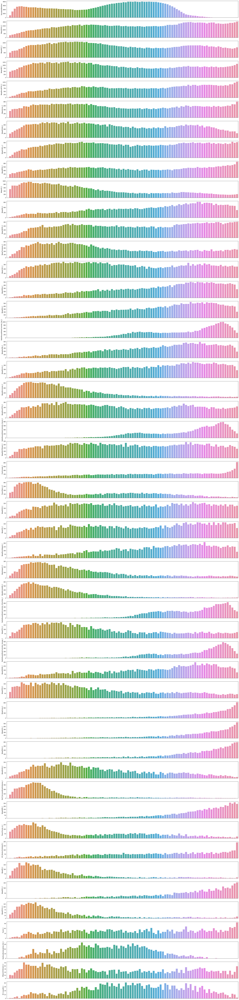

In [194]:
# plotting the weapon used for each kill. also includes vehicles and bluezone damage(specific to each map)
#you can group these by trend, similiar weapons have similiar plots. The assault rifles have relatively steady use throughout (WeapHK416, WeapAK47, WeapBerylM762)
# the DMRs/snipers have little use at the start but slowly increases over the game (WeapMini14, WeapSKSWeapFNFAL, WeapKar98k, WeapM24)
# some weapon have a lot of use at the start, and very little after (shotguns, pistols, fists)
# guns which are only available from supply drops only appear 1/5th of the way through, and very slowly increase but are prominent towards the end.

death_damage_weapon.sum().sort_values(ascending=False)[:50]

plt.figure(figsize=(34,150))
for num, i in enumerate(death_damage_weapon.sum().sort_values(ascending=False)[:50].index):
    plt.subplot(50,1,num+1)
    sns.barplot(x=death_damage_weapon.index, y=i, data=death_damage_weapon,orient='v')
    plt.xticks([])

## Here we are making a new dataframe, only comprising of one map.

#### We are looking for differences in play style across a players final position.

In [34]:
baltic_df = df[df.mapName == 'Baltic_Main']

In [35]:
baltic_landings = baltic_df[[x for x in df.columns if 'landing_location' in x]]

In [36]:
#processing the location data so it can be used.
# have to build different strippers because different maps are different sizes..
def location_stripper_x(location):
    try:
        if np.isnan(location) == True:
            return location
    except:
        return float(location.replace(',','').split()[1])/1000
    
def location_stripper_y_baltic(location):
    try:
        if np.isnan(location) == True:
            return location
    except:
        return float(location.replace(',','').split()[3])/1000

In [37]:
for i in baltic_landings.columns:
    baltic_landings[i+'_x'] = baltic_landings[i].apply(location_stripper_x)
    baltic_landings[i+'_y'] = baltic_landings[i].apply(location_stripper_y_baltic)

<ipython-input-37-a038e5426842>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_landings[i+'_x'] = baltic_landings[i].apply(location_stripper_x)
<ipython-input-37-a038e5426842>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_landings[i+'_y'] = baltic_landings[i].apply(location_stripper_y_baltic)


In [38]:
#making a new dataframe which only includes landing data of key players.
baltic_landings_xy = baltic_landings[[x for x in baltic_landings.columns if 'landing_location_' in x]]

In [41]:
baltic_landings_xy

,P_1_landing_location_x,P_1_landing_location_y,P_2_landing_location_x,P_2_landing_location_y,P_3_landing_location_x,P_3_landing_location_y,P_mid_landing_location_x,P_mid_landing_location_y,P_last_but10_landing_location_x,P_last_but10_landing_location_y,P_last_landing_location_x,P_last_landing_location_y,K_1_landing_location_x,K_1_landing_location_y,K_2_landing_location_x,K_2_landing_location_y,K_3_landing_location_x,K_3_landing_location_y,P_mid2_landing_location_x,P_mid2_landing_location_y
0,384.318781,119.034484,415.071219,478.610313,558.868563,487.102688,673.843813,516.650375,634.089313,598.291438,421.878531,324.544406,215.824859,275.738344,384.318781,119.034484,561.255500,379.094375,558.784437,389.620875
1,560.627062,220.401797,684.099312,461.228000,377.641656,301.303750,598.474438,615.817625,382.741812,619.130750,532.585187,638.046563,373.759719,505.371125,684.099312,461.228000,560.627062,220.401797,528.907063,596.470375
2,585.738500,477.892844,495.420031,191.787125,137.758156,584.397563,704.965125,341.633406,437.532156,637.084187,694.159313,223.505219,320.637031,332.318125,374.480781,307.194563,679.373375,389.885781,380.753938,567.996625
3,687.437250,462.368594,290.954187,573.659313,621.584812,376.801656,117.028656,577.933313,435.481969,450.362281,722.084313,424.355563,687.437250,462.368594,424.884625,326.437406,290.954187,573.659313,374.154625,410.489594
6,371.140594,415.642625,157.229000,280.134250,NaN,NaN,NaN,NaN,NaN,NaN,455.004656,438.621281,157.229000,280.134250,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4612,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4613,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4614,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4615,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Here we are creating a gaussian filter to assign a colour value to the points on scatter plot to show the density. We're also overlaying it over the map for a good visual idea of where players in certain positions are chosing to land. There are some clear visible differences between people winning vs losers.

#### High performing players tend to gravitate towards busy areas in the middle of the map. Mid placing players are slightly more dispersed, and players who lose can be seen landing around the edge of the map. This could be due to a game mechanic; if a player quits the match after it has started, but before players exit the starter plane, they will be ejected at the end of the flight path.

In [43]:
import matplotlib.cm as cm
from scipy.ndimage.filters import gaussian_filter
from scipy.stats import gaussian_kde

def myplot(x, y, s, bins=1000):
    heatmap, xedges, yedges = np.histogram2d(x, y, bins=bins)
    heatmap = gaussian_filter(heatmap, sigma=s)

    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    return heatmap.T, extent

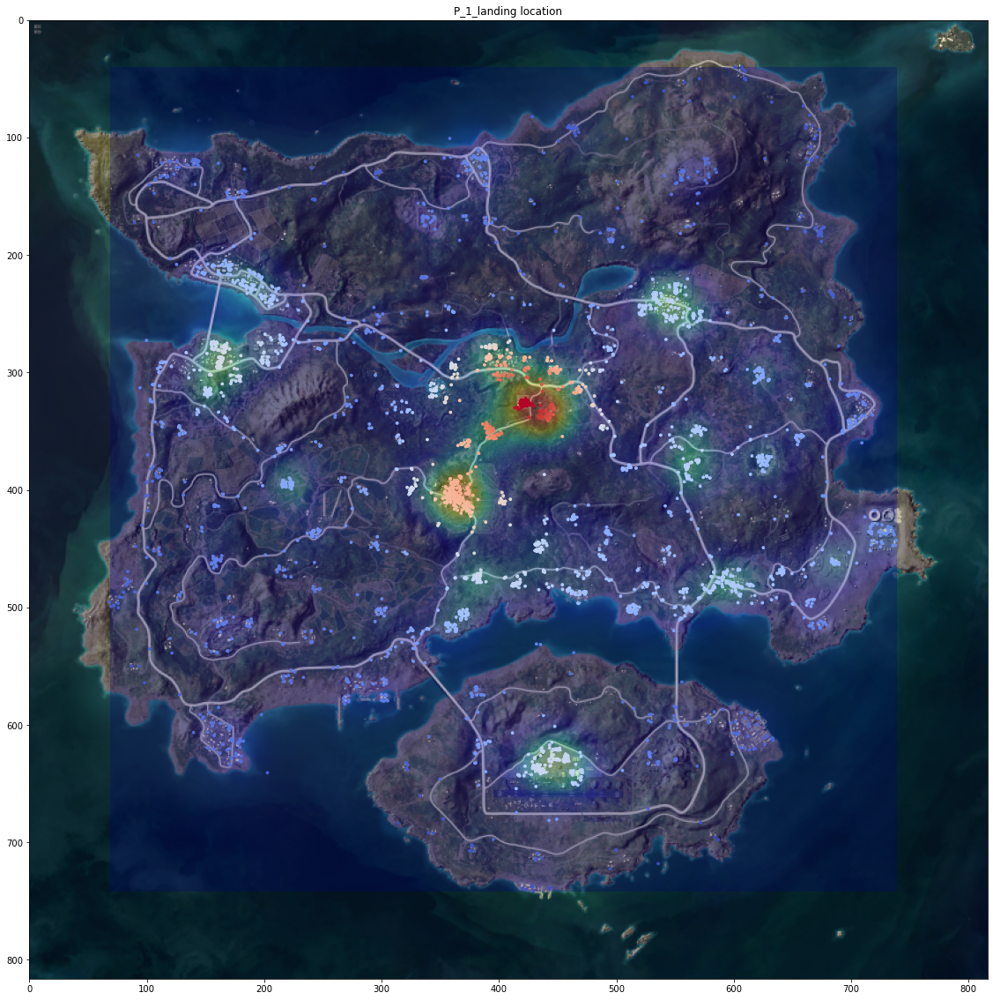

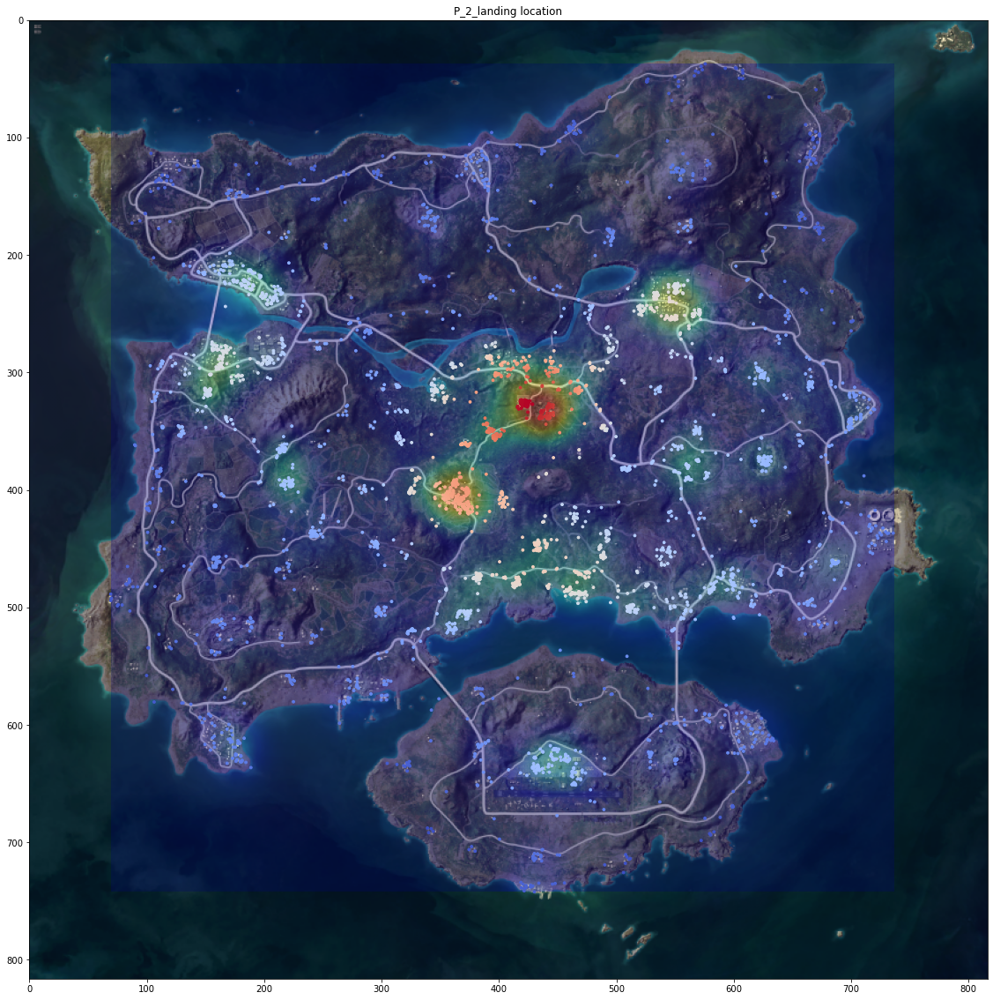

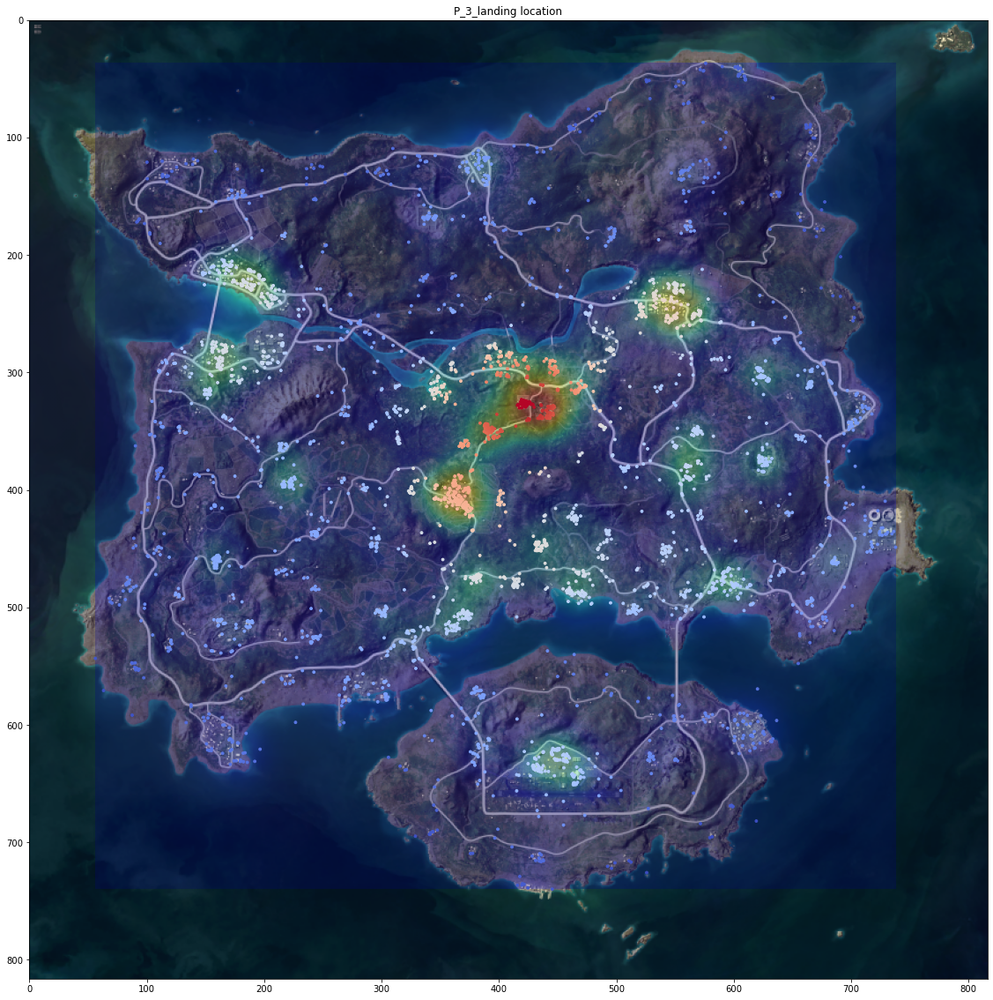

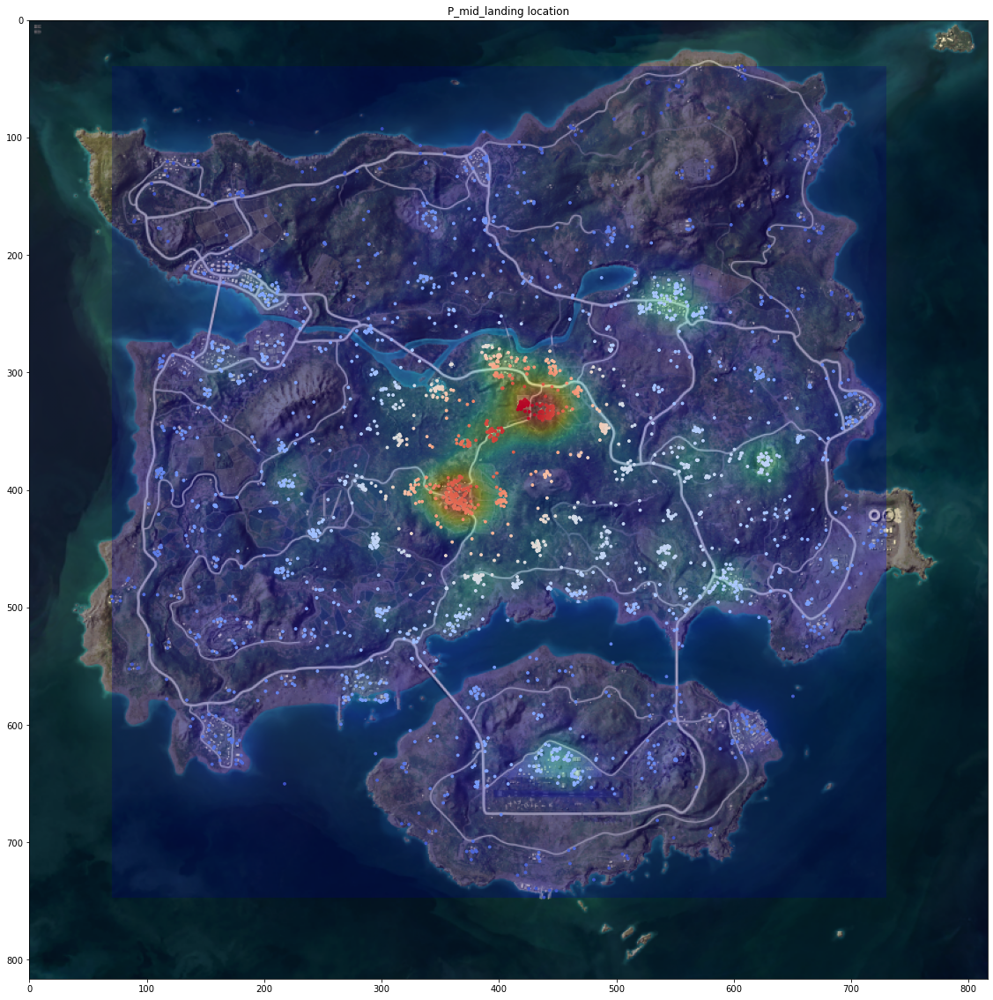

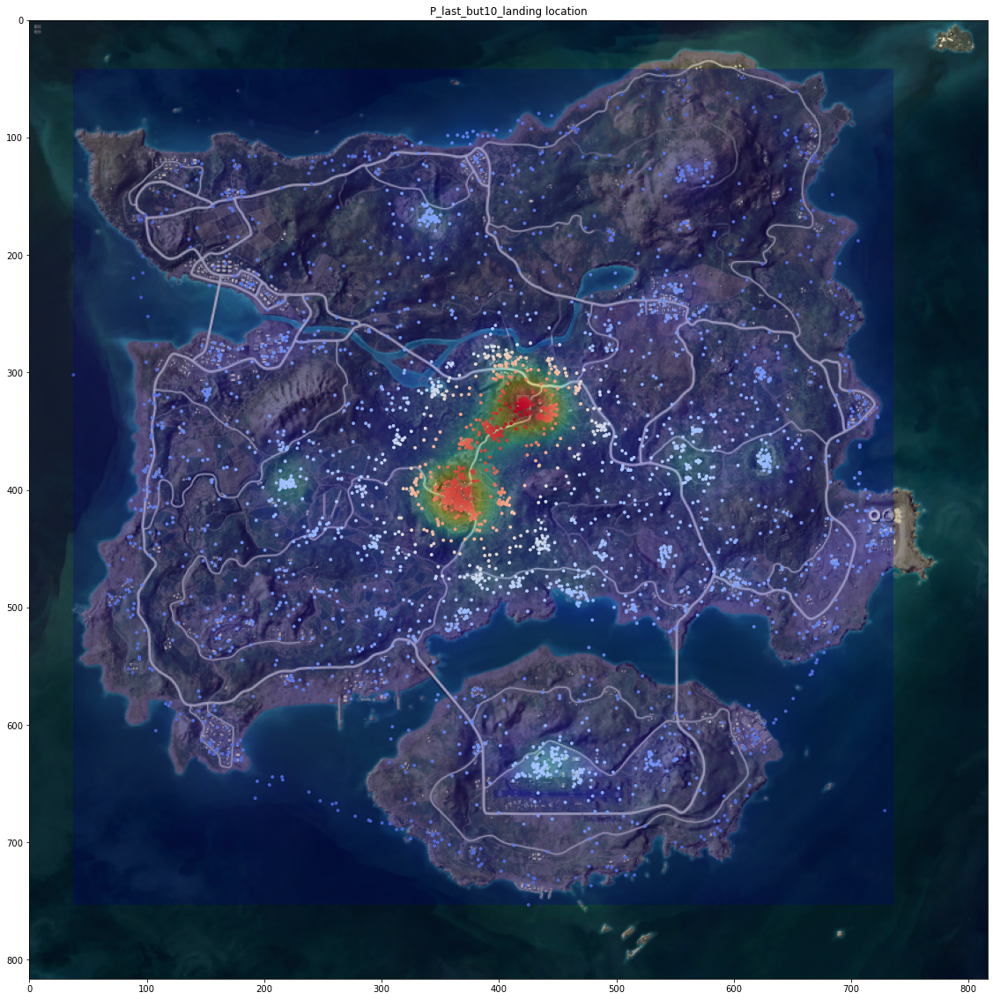

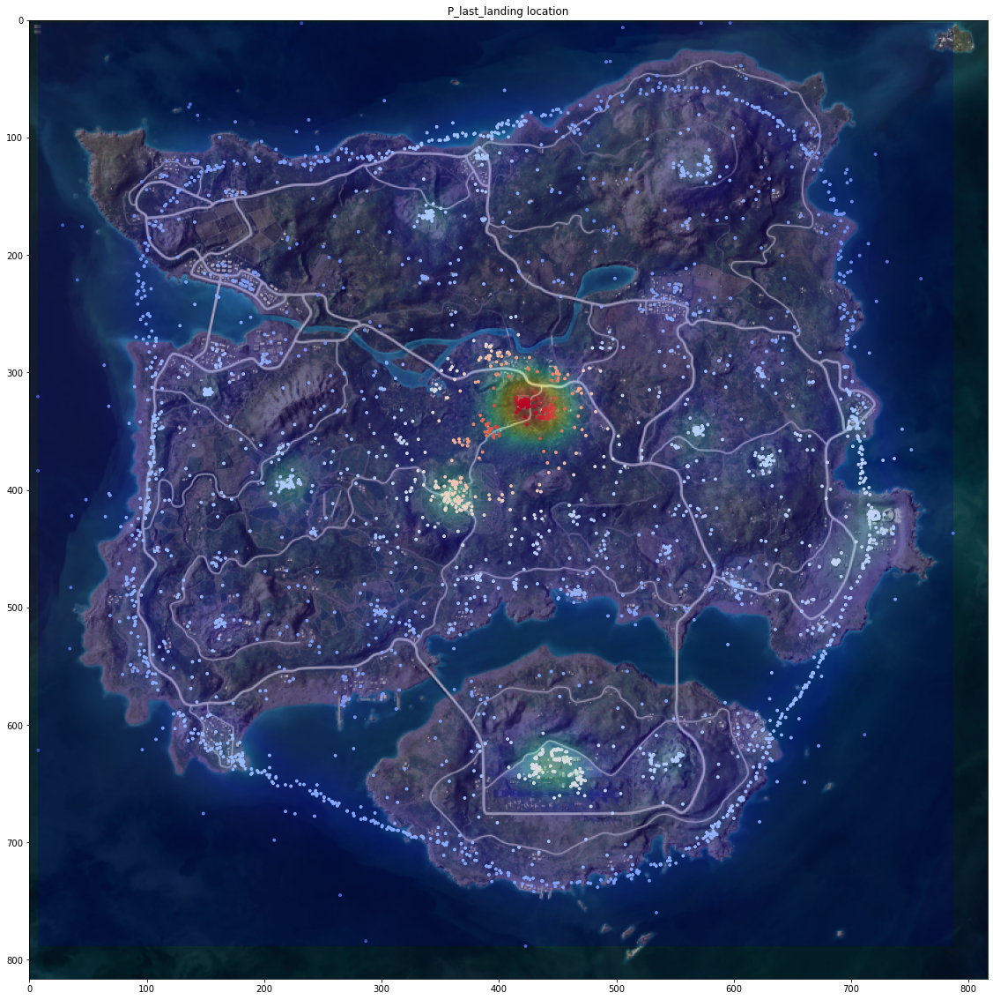

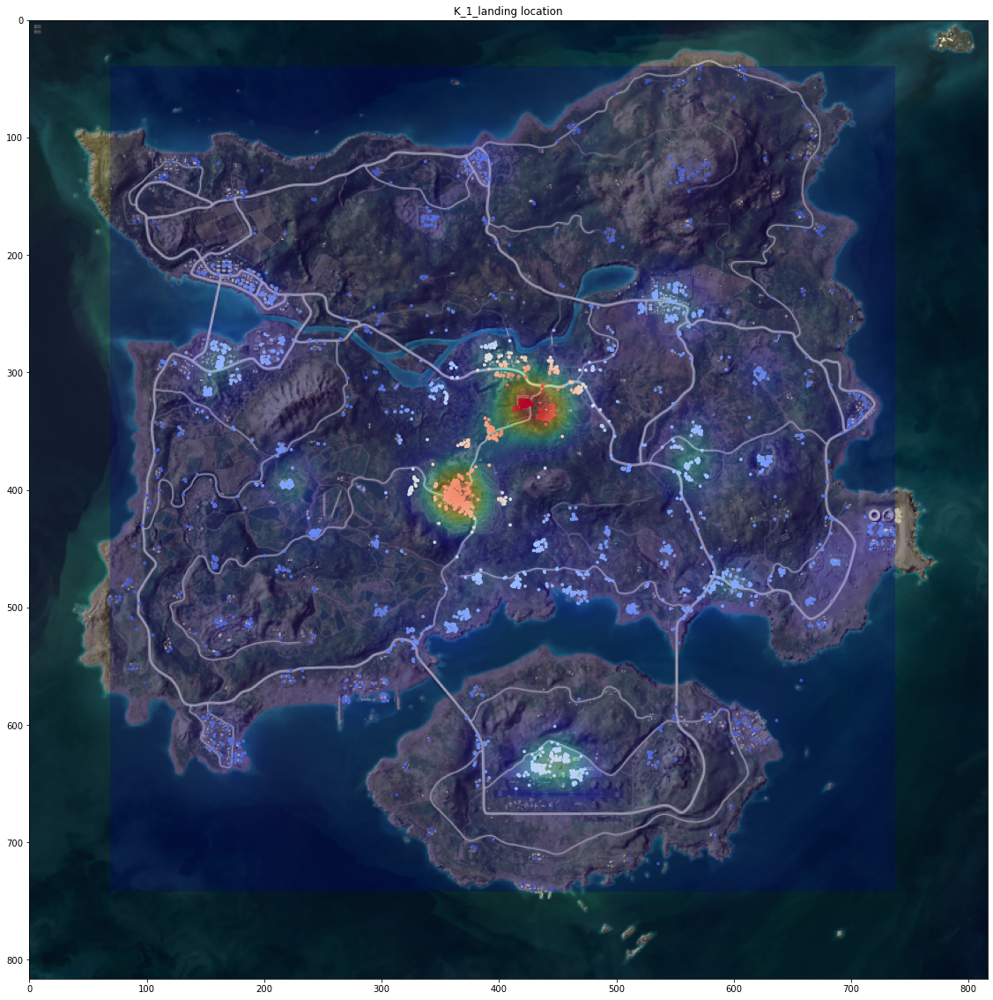

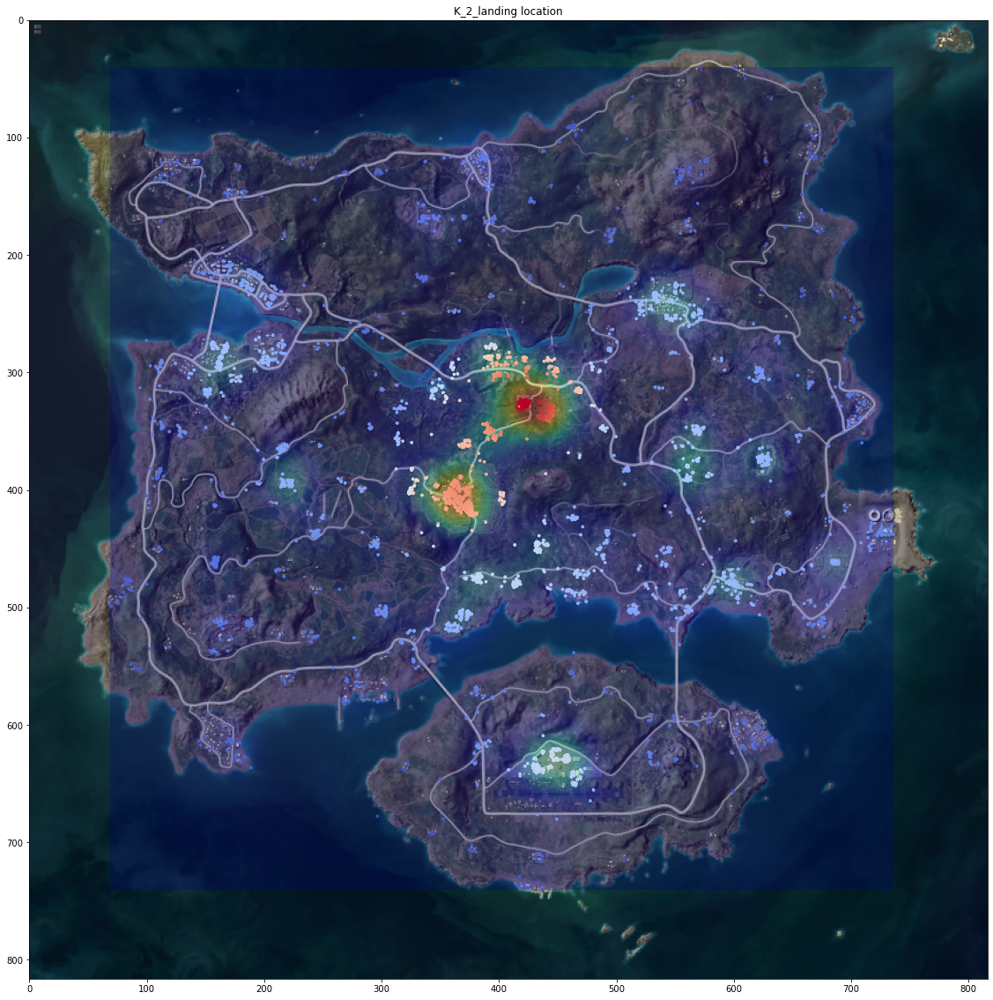

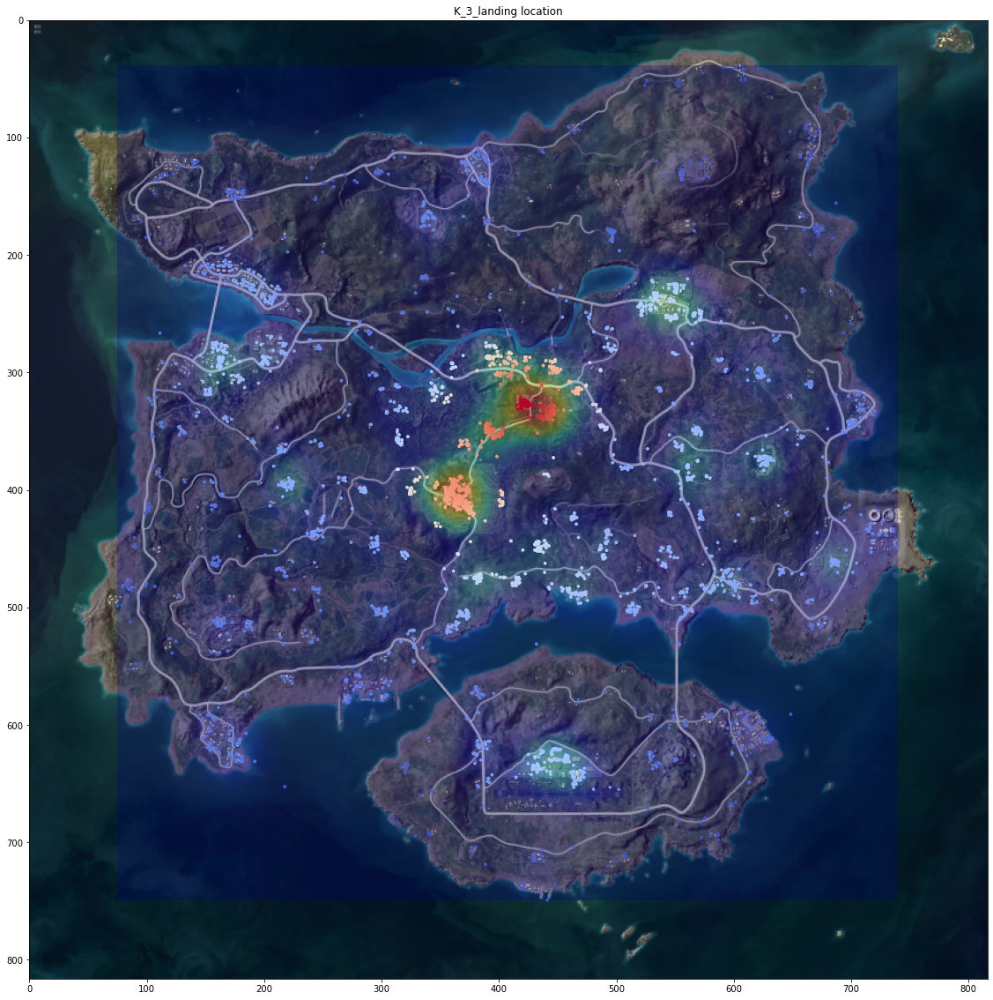

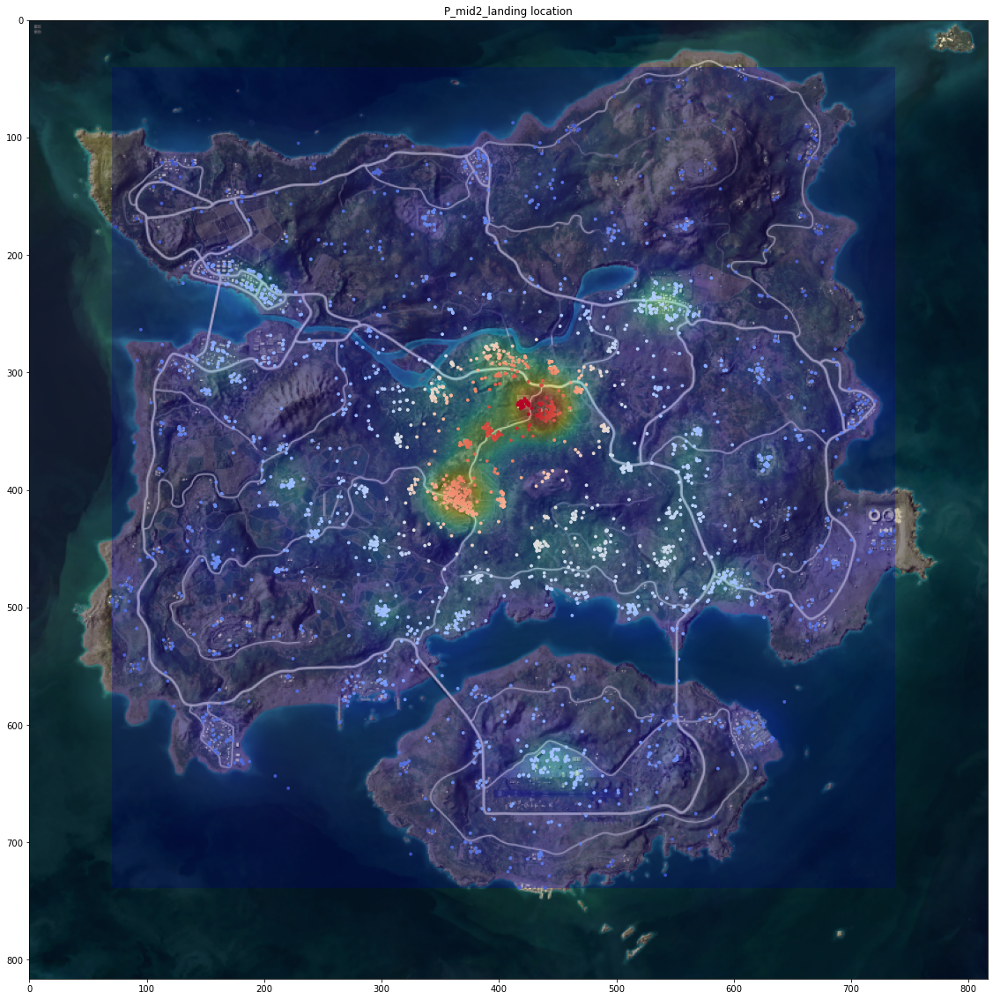

In [314]:
#Heatmap showing were top,mid and lowest placed players land. Look at the title to find out which.
for i in [x[:-18] for x in baltic_landings_xy.columns if 'ion_x' in x]:
    fig, ax = plt.subplots(figsize=(20,20))
    testdf = baltic_landings_xy[[x for x in baltic_landings_xy.columns if i in x]].copy()
    testdf.dropna(inplace=True)
    x = testdf[i+ 'landing_location_x']
    y = testdf[i+ 'landing_location_y']
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    idx = z.argsort()
    x,y,z = x.iloc[idx],y.iloc[idx],z[idx]
    im = plt.imread('/Users/tim/Desktop/GA/lessons/DSI16-lessons/project/project-capstone/My capstone/images/Erangel_Main_No_Text_Low_Res.png')
    implot = plt.imshow(im)
    img, extent = myplot(x, y, 25)
    ax.imshow(img, extent=extent, origin='lower',alpha=0.25 ,cmap=cm.jet)
    ax.set_title(i + 'landing location')
    ax.scatter(x, y, c=z,cmap='coolwarm', s=8)
    plt.ylim([0,816])
    plt.xlim([0,816])
    plt.gca().invert_yaxis()

In [46]:
#pulling column names to search
for_boxplots = [x for x in df_100_player_maps.columns if 'P_1_' in x][:18]

In [47]:
#removing columns we don't want to search
for_boxplots.remove('P_1_deathType')
for_boxplots.remove('P_1_name')
for_boxplots.remove('P_1_killStreaks')
for_boxplots.remove('P_1_playerId')

#### Here we are looking at how much of various utensils a player used over the game. There are some clear differences between these key players. Only 1st place and 2nd place will have been alive the same ammount of time, so these are of most interesting/most comparable. These suggest that a top placing player might be more active than a player who comes second, based on their distance travelled, damaged dealt and and longest kill.

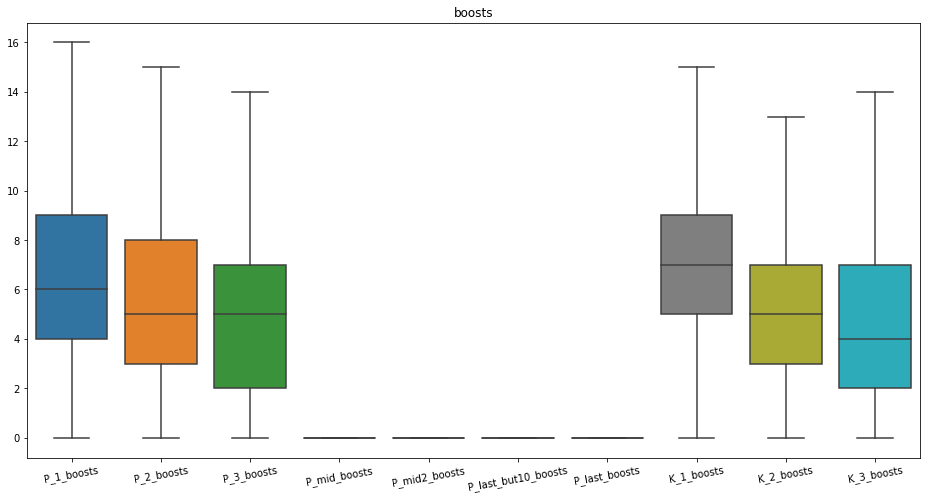

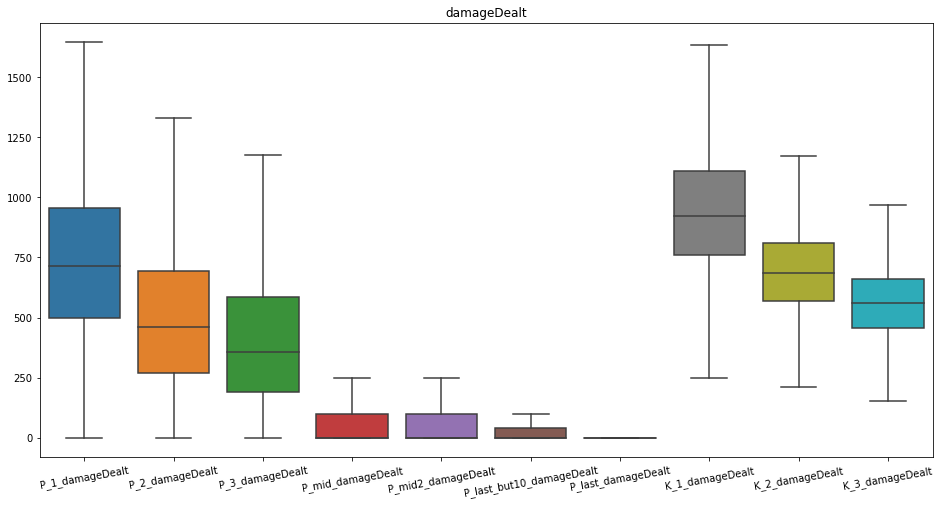

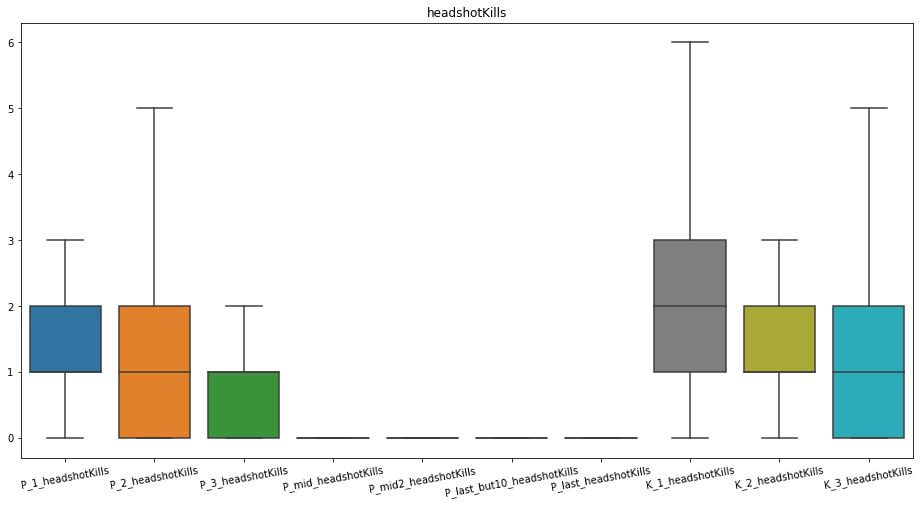

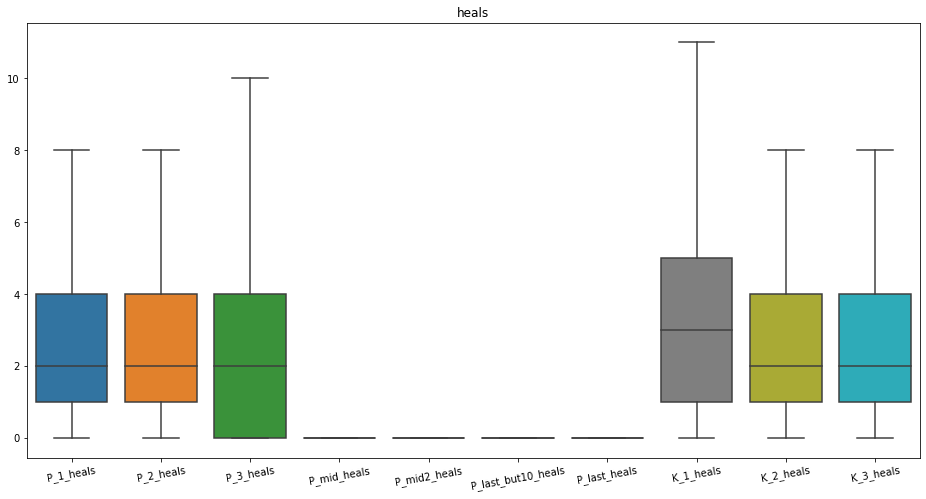

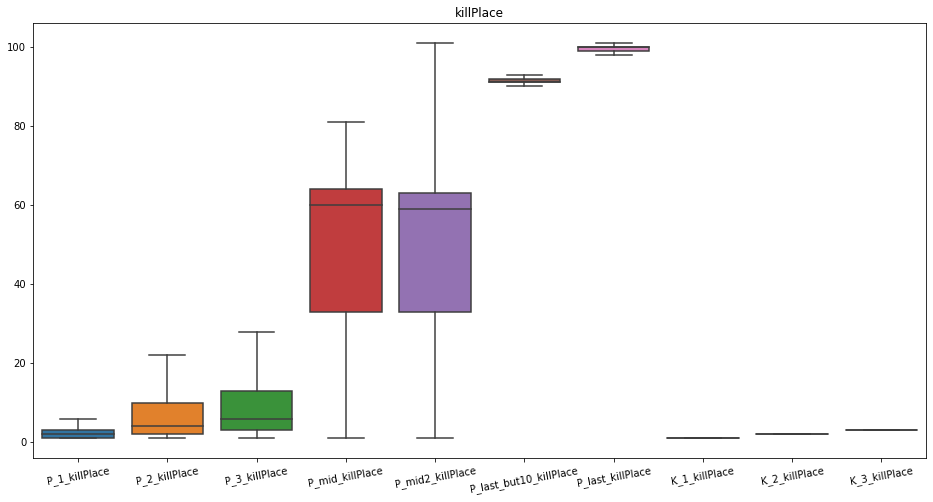

...

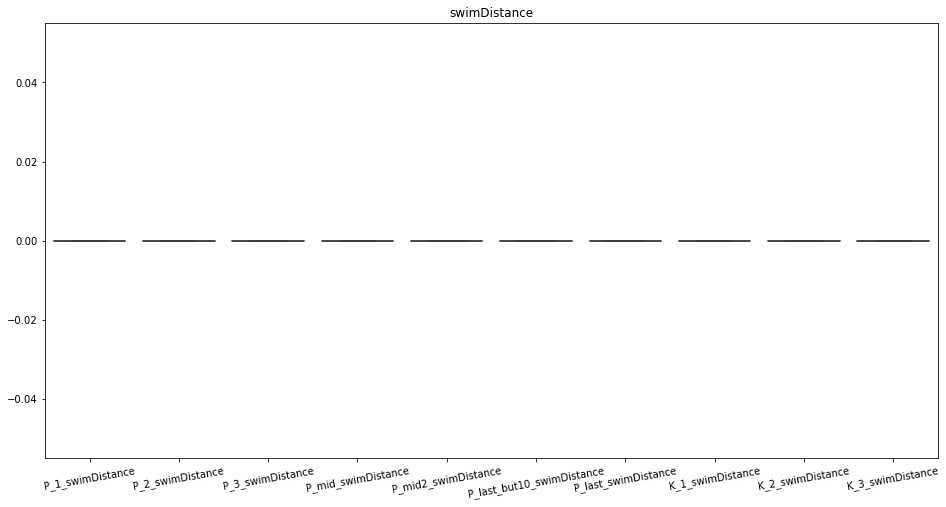

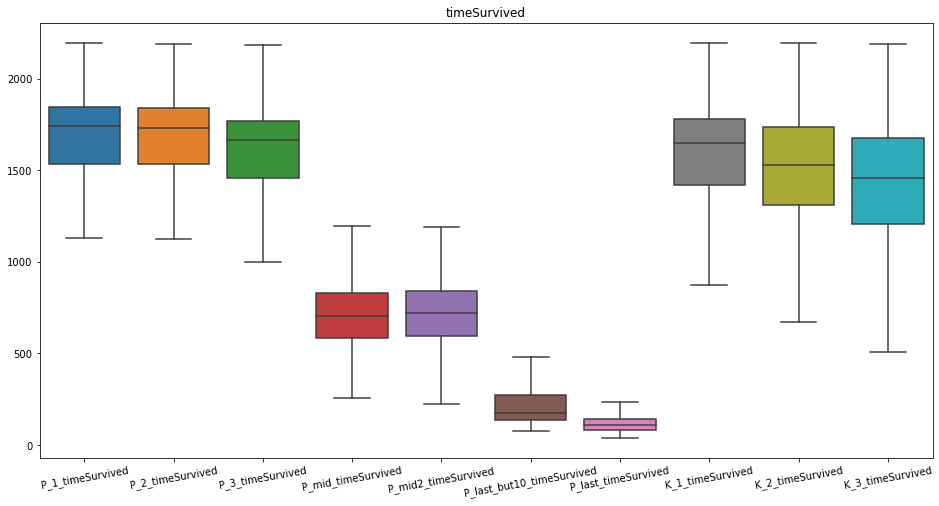

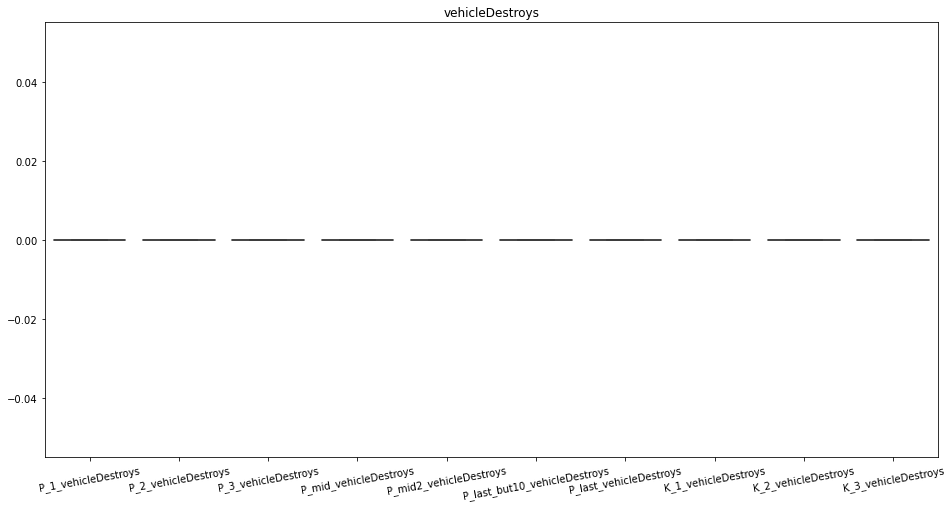

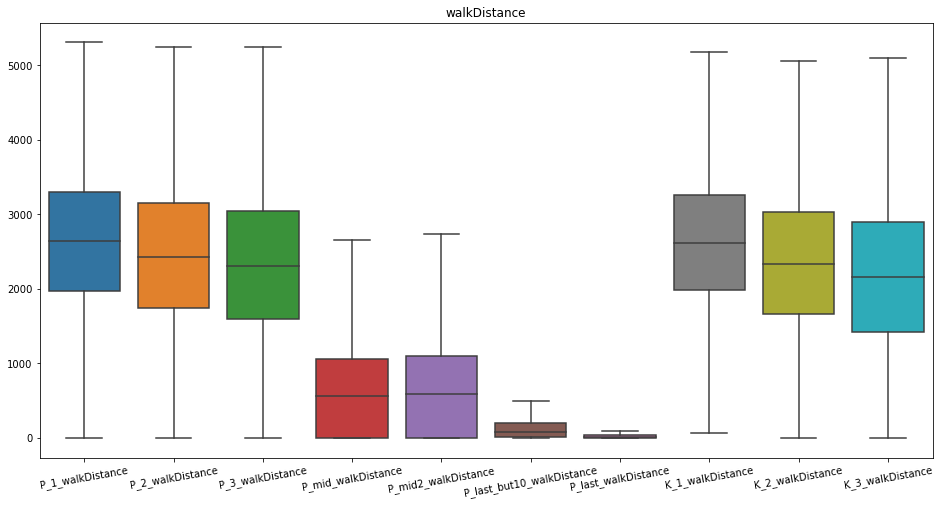

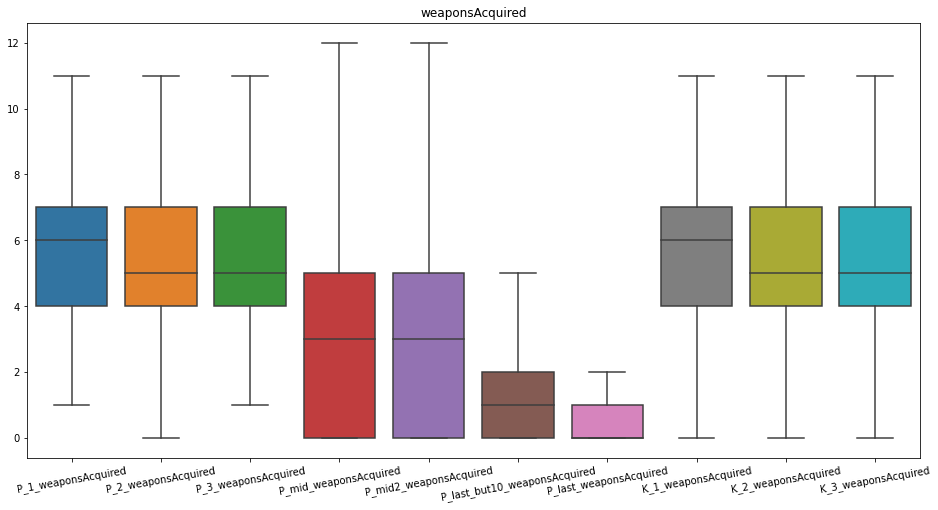

In [313]:
#A look at different metrics accross top, mid and bottom placing players, as well as kill leaders.

plt.figure(figsize=(16,120))
for num, i in enumerate(for_boxplots):
    plt.subplot(15,1,num+1)
    sns.boxplot(data=df_100_player_maps[[x for x in df_100_player_maps.columns if i[3:] in x]], orient='v',showfliers=False, fliersize=0.5)
    plt.title(i[4:])
    plt.xticks(rotation=10)

# Match visualisations
#### With the data we collected, we could also effecitvely recreate a match. Here is an example of that.

In [50]:
example_match = df[[x for x in df.columns if 'poisonGasWarning' in x]+[x for x in df.columns if 'flight' in x]].iloc[:1]

In [51]:
example_match

,GS_0.1_poisonGasWarningPosition,GS_0.1_poisonGasWarningRadius,GS_1.0_poisonGasWarningPosition,GS_1.0_poisonGasWarningRadius,GS_1.5_poisonGasWarningPosition,GS_1.5_poisonGasWarningRadius,GS_2.0_poisonGasWarningPosition,GS_2.0_poisonGasWarningRadius,GS_2.5_poisonGasWarningPosition,GS_2.5_poisonGasWarningRadius,GS_3.0_poisonGasWarningPosition,GS_3.0_poisonGasWarningRadius,GS_3.5_poisonGasWarningPosition,GS_3.5_poisonGasWarningRadius,GS_4.0_poisonGasWarningPosition,GS_4.0_poisonGasWarningRadius,GS_4.5_poisonGasWarningPosition,GS_4.5_poisonGasWarningRadius,GS_5.0_poisonGasWarningPosition,GS_5.0_poisonGasWarningRadius,GS_5.5_poisonGasWarningPosition,GS_5.5_poisonGasWarningRadius,GS_6.0_poisonGasWarningPosition,GS_6.0_poisonGasWarningRadius,GS_6.5_poisonGasWarningPosition,GS_6.5_poisonGasWarningRadius,GS_7.0_poisonGasWarningPosition,GS_7.0_poisonGasWarningRadius,GS_7.5_poisonGasWarningPosition,GS_7.5_poisonGasWarningRadius,GS_8.0_poisonGasWarningPosition,GS_8.0_poisonGasWarningRadius,GS_8.5_poisonGasWarningPosition,GS_8.5_poisonGasWarningRadius,GS_9.0_poisonGasWarningPosition,GS_9.0_poisonGasWarningRadius,GS_9.5_poisonGasWarningPosition,GS_9.5_poisonGasWarningRadius,GS_10._poisonGasWarningPosition,GS_10._poisonGasWarningRadius,first_flight_location,last_flight_location
0,"{'x': 0, 'y': 0, 'z': 0}",0.0,"{'x': 576688.875, 'y': 208690.96875, 'z': 0}",202901.53125,"{'x': 576688.875, 'y': 208690.96875, 'z': 0}",202901.53125,"{'x': 575342.625, 'y': 138220.828125, 'z': 0}",121740.921875,"{'x': 575342.625, 'y': 138220.828125, 'z': 0}",121740.921875,"{'x': 606991.125, 'y': 154758.28125, 'z': 0}",66957.507812,"{'x': 606991.125, 'y': 154758.28125, 'z': 0}",66957.507812,"{'x': 577635.75, 'y': 152369.8125, 'z': 0}",36826.628906,"{'x': 577635.75, 'y': 152369.8125, 'z': 0}",36826.628906,"{'x': 582748.5625, 'y': 150666.109375, 'z': 0}",18413.314453,"{'x': 582748.5625, 'y': 150666.109375, 'z': 0}",18413.314453,"{'x': 583322.125, 'y': 159293.09375, 'z': 0}",9206.657227,"{'x': 583322.125, 'y': 159293.09375, 'z': 0}",9206.657227,"{'x': 586597.5625, 'y': 156779.75, 'z': 0}",4603.328613,"{'x': 586597.5625, 'y': 156779.75, 'z': 0}",4603.328613,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{'x': 63402.28125, 'y': -54766.1875, 'z': 150208}","{'x': 631634.1875, 'y': 593987.375, 'z': 150208}"


In [52]:
#stripping the x and y coordinates from the play area location columns...
for i in example_match[[x for x in df.columns if 'WarningPosition' in x]]:
    example_match[i+'_x'] = example_match[i].apply(location_stripper_x)
    example_match[i+'_y'] = example_match[i].apply(location_stripper_y_baltic)

In [53]:
#dropping N/A columns
example_match.dropna(axis=1, how='all', inplace=True)

In [54]:
#pulling all columns with death info in them
example_death_df = df[[x for x in df.columns if 'death#' in x]].iloc[:1]

In [55]:
example_death_df

,death#0_victim_accountId,death#0_victim_location,death#0_victim_ranking,death#0_finisher_accountId,death#0_finisher_location,death#0_finisher_health,death#0_finisher_ranking,death#0_finishDamageInfo_damageReason,death#0_finishDamageInfo_damageTypeCategory,death#0_finishDamageInfo_damageCauserName,death#0_finishDamageInfo_distance,death#0_isSuicide_,death#0_common_,death#0__D_,death#1_victim_accountId,death#1_victim_location,death#1_victim_ranking,death#1_finisher_accountId,death#1_finisher_location,death#1_finisher_health,death#1_finisher_ranking,death#1_finishDamageInfo_damageReason,death#1_finishDamageInfo_damageTypeCategory,death#1_finishDamageInfo_damageCauserName,death#1_finishDamageInfo_distance,death#1_isSuicide_,death#1_common_,death#1__D_,death#2_victim_accountId,death#2_victim_location,death#2_victim_ranking,death#2_finisher_accountId,death#2_finisher_location,death#2_finisher_health,death#2_finisher_ranking,death#2_finishDamageInfo_damageReason,death#2_finishDamageInfo_damageTypeCategory,death#2_finishDamageInfo_damageCauserName,death#2_finishDamageInfo_distance,death#2_isSuicide_,death#2_common_,death#2__D_,death#3_victim_accountId,death#3_victim_location,death#3_victim_ranking,death#3_finisher_accountId,death#3_finisher_location,death#3_finisher_health,death#3_finisher_ranking,death#3_finishDamageInfo_damageReason,death#3_finishDamageInfo_damageTypeCategory,death#3_finishDamageInfo_damageCauserName,death#3_finishDamageInfo_distance,death#3_isSuicide_,death#3_common_,death#3__D_,death#4_victim_accountId,death#4_victim_location,death#4_victim_ranking,death#4_finisher_accountId,death#4_finisher_location,death#4_finisher_health,death#4_finisher_ranking,death#4_finishDamageInfo_damageReason,death#4_finishDamageInfo_damageTypeCategory,death#4_finishDamageInfo_damageCauserName,death#4_finishDamageInfo_distance,death#4_isSuicide_,death#4_common_,death#4__D_,death#5_victim_accountId,death#5_victim_location,death#5_victim_ranking,death#5_finisher_accountId,death#5_finisher_location,death#5_finisher_health,death#5_finisher_ranking,death#5_finishDamageInfo_damageReason,death#5_finishDamageInfo_damageTypeCategory,death#5_finishDamageInfo_damageCauserName,death#5_finishDamageInfo_distance,death#5_isSuicide_,death#5_common_,death#5__D_,death#6_victim_accountId,death#6_victim_location,death#6_victim_ranking,death#6_finisher_accountId,death#6_finisher_location,death#6_finisher_health,death#6_finisher_ranking,death#6_finishDamageInfo_damageReason,death#6_finishDamageInfo_damageTypeCategory,death#6_finishDamageInfo_damageCauserName,death#6_finishDamageInfo_distance,death#6_isSuicide_,death#6_common_,death#6__D_,death#7_victim_accountId,death#7_victim_location,death#7_victim_ranking,death#7_finisher_accountId,death#7_finisher_location,death#7_finisher_health,death#7_finisher_ranking,death#7_finishDamageInfo_damageReason,death#7_finishDamageInfo_damageTypeCategory,death#7_finishDamageInfo_damageCauserName,death#7_finishDamageInfo_distance,death#7_isSuicide_,death#7_common_,death#7__D_,death#8_victim_accountId,death#8_victim_location,death#8_victim_ranking,death#8_finisher_accountId,death#8_finisher_location,death#8_finisher_health,death#8_finisher_ranking,death#8_finishDamageInfo_damageReason,death#8_finishDamageInfo_damageTypeCategory,death#8_finishDamageInfo_damageCauserName,death#8_finishDamageInfo_distance,death#8_isSuicide_,death#8_common_,death#8__D_,death#9_victim_accountId,death#9_victim_location,death#9_victim_ranking,death#9_finisher_accountId,death#9_finisher_location,death#9_finisher_health,death#9_finisher_ranking,death#9_finishDamageInfo_damageReason,death#9_finishDamageInfo_damageTypeCategory,death#9_finishDamageInfo_damageCauserName,death#9_finishDamageInfo_distance,death#9_isSuicide_,death#9_common_,death#9__D_,death#10_victim_accountId,death#10_victim_location,death#10_victim_ranking,death#10_finisher_accountId,death#10_finisher_location,death#10_finisher_health,death#10_finisher_ranking,death#10_finishDamageInfo_da

In [56]:
df

matchId             createdAt  duration  \
0      7373654d-5bc9-4ce4-92e3-963377f9b079  2021-04-08T00:15:57Z      1754   
1      d0311463-0dd6-4561-acc5-d00f6c5eaf4a  2021-04-18T03:03:35Z      1728   
2      0a2c4387-392b-4d5e-86cf-c836ac589921  2021-04-17T02:05:03Z      1943   
3      58943bf7-3a97-444a-8f78-3fb3768bcc8e  2021-04-12T16:09:30Z      1836   
4      dcd9dc35-3656-4c00-b134-73c382ba82cf  2021-04-17T04:26:09Z      1677   
...                                     ...                   ...       ...   
18980  01c6952c-d98a-4daf-a798-42d61e16dea5  2021-04-16T20:27:57Z      1855   
18981  577966c2-8265-451a-a337-faba54e86a5b  2021-04-17T12:31:07Z      1672   
18982  771999f8-4a7f-4e70-ae5f-ddd0da22f2c6  2021-04-10T10:31:00Z      1915   
18983  9869fa00-4203-4af8-854c-492e99efb2e2  2021-04-13T16:09:48Z      1727   
18984  3211152e-0061-4375-aa25-2e07fdd7f804  2021-04-16T12:04:45Z      1976   

      gameMode  isCustomMatch         mapName matchType seasonState  shardId  \
0         solo          False     Baltic_Main  official    progress  console   
1         solo          False     Baltic_Main  official    progress  console   
2         solo          False     Baltic_Main  official    progress  console   
3         solo          False     Baltic_Main  official    progress  console   
4         solo          False  DihorOtok_Main  official    progress  console   
...        ...            ...             ...       ...         ...      ...   
18980     solo          False     Desert_Main  official    progress  console   
18981     solo          False  DihorOtok_Main  official    progress  console   
18982     solo          False     Desert_Main  official    progress  console   
18983     solo          False  DihorOtok_Main  official    progress  console   
18984     solo          False     Desert_Main  official    progress  console   

             titleId                                      telemetry_url  \
0      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
1      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
2      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
3      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
4      bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
...              ...                                                ...   
18980  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18981  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18982  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18983  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   
18984  bluehole-pubg  https://telemetry-cdn.pubg.com/bluehole-pubg/c...   

       P_1_boosts  P_1_damageDealt P_1_deathType  P_1_headshotKills  \
0              12        786.93050         alive                  2   
1               4        538.64124         alive                  1   
2               0        463.15286         alive                  0   
3              12        682.55054         alive                  2   
4               7        906.94250         alive                  5   
...           ...              ...           ...                ...   
18980           6        583.26920         alive                  3   
18981           8       1317.36740         alive                  4   
18982          15       1283.16850         alive                  1   
18983           7        497.06842         alive                  0   
18984           8        808.59690         alive                  4   

       P_1_heals  P_1_killPlace  P_1_killStreaks  P_1_kills  P_1_longestKill  \
0              3              2                1          7        81.727690   
1              6              3                1          5        68.060800   
2              2              4                1          4        45.598080   
3              5              1                1    

In [57]:
#Making a new dataframe from the deaths in the row of this match.


big_temp_list = []
for i in range(100):
    temp_list = []
    temp_list.append(i)
    temp_list.append(example_death_df['death#'+str(i)+'_victim_accountId'][0])
    temp_list.append(location_stripper_x(example_death_df['death#'+str(i)+'_victim_location'][0]))
    temp_list.append(location_stripper_y_baltic(example_death_df['death#'+str(i)+'_victim_location'][0]))
    temp_list.append(example_death_df['death#'+str(i)+'_victim_ranking'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finisher_accountId'][0])
    temp_list.append(location_stripper_x(example_death_df['death#'+str(i)+'_finisher_location'][0]))
    temp_list.append(location_stripper_y_baltic(example_death_df['death#'+str(i)+'_finisher_location'][0]))
    temp_list.append(example_death_df['death#'+str(i)+'_finisher_health'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finisher_ranking'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finishDamageInfo_damageReason'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finishDamageInfo_damageTypeCategory'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finishDamageInfo_damageCauserName'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_finishDamageInfo_distance'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_isSuicide_'][0])
    temp_list.append(example_death_df['death#'+str(i)+'_common_'][0])
    temp_list.append(example_death_df['death#'+str(i)+'__D_'][0])
    big_temp_list.append(temp_list)
    
#making a list of column names
mini_death_df_col_names = []
mini_death_df_col_names.append('death_#')
mini_death_df_col_names.append('victim_accountId')
mini_death_df_col_names.append('victim_location_x')
mini_death_df_col_names.append('victim_location_y')
mini_death_df_col_names.append('victim_ranking')
mini_death_df_col_names.append('finisher_accountId')
mini_death_df_col_names.append('finisher_location_x')
mini_death_df_col_names.append('finisher_location_y')
mini_death_df_col_names.append('finisher_health')
mini_death_df_col_names.append('finisher_ranking')
mini_death_df_col_names.append('finishDamageInfo_damageReason')
mini_death_df_col_names.append('finishDamageInfo_damageTypeCategory')
mini_death_df_col_names.append('finishDamageInfo_damageCauserName')
mini_death_df_col_names.append('finishDamageInfo_distance')
mini_death_df_col_names.append('isSuicide')
mini_death_df_col_names.append('gameState')
mini_death_df_col_names.append('timestamp')

mini_death_df = pd.DataFrame(data=big_temp_list, columns=mini_death_df_col_names)
mini_death_df

,death_#,victim_accountId,victim_location_x,victim_location_y,victim_ranking,finisher_accountId,finisher_location_x,finisher_location_y,finisher_health,finisher_ranking,finishDamageInfo_damageReason,finishDamageInfo_damageTypeCategory,finishDamageInfo_damageCauserName,finishDamageInfo_distance,isSuicide,gameState,timestamp
0,0,account.ac032d51cd9c47b482dadf4858b7686a,580.263625,157.275750,2.0,account.d25a7c228fb94024813f909f4892ba4f,582.567188,157.548234,100.000000,0.0,TorsoShot,Damage_Gun,WeapHK416_C,2321.666748,False,{'isGame': 7.5},2021-04-08T00:45:03.615Z
1,1,account.c342c360c6bb4756bd8e930be503a201,581.282125,160.841750,3.0,account.ac032d51cd9c47b482dadf4858b7686a,580.682250,159.945844,44.399998,0.0,TorsoShot,Damage_Gun,WeapGroza_C,1098.807617,False,{'isGame': 7},2021-04-08T00:44:30.678Z
2,2,account.e56ee9b7057e434e890722e09245a192,591.408312,156.961437,4.0,account.d25a7c228fb94024813f909f4892ba4f,587.786375,154.539547,100.000000,0.0,HeadShot,Damage_Gun,WeapMk47Mutant_C,4520.905762,False,{'isGame': 7},2021-04-08T00:43:58.414Z
3,3,account.e3aeac37a4ec40148b4ce77bb7f7ff0e,571.419937,159.975594,5.0,account.ac032d51cd9c47b482dadf4858b7686a,574.469687,149.965438,100.000000,0.0,PelvisShot,Damage_Gun,WeapVSS_C,11051.463867,False,{'isGame': 6.5},2021-04-08T00:43:36.672Z
4,4,account.0ddd47cd06424bb7aaabe3dbc81eb7ac,585.010313,146.327719,6.0,account.d25a7c228fb94024813f909f4892ba4f,581.316438,145.161672,100.000000,0.0,TorsoShot,Damage_Gun,WeapHK416_C,4029.646729,False,{'isGame': 6.5},2021-04-08T00:43:18.804Z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,account.6f534af5b8ae413082a6d74f53b977a5,422.480406,325.275094,97.0,account.6c78340719264962978b0ed5cec95138,420.850719,326.181281,94.148628,0.0,TorsoShot,Damage_Gun,WeapNagantM1895_C,1865.924072,False,{'isGame': 0.10000000149011612},2021-04-08T00:17:21.711Z
96,96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
97,97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,98,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
#stripping the x and y coordinates from the flight path columns...
for i in example_match[[x for x in df.columns if 'flight_location' in x]]:
    example_match[i+'_x'] = example_match[i].apply(location_stripper_x)
    example_match[i+'_y'] = example_match[i].apply(location_stripper_y_baltic)

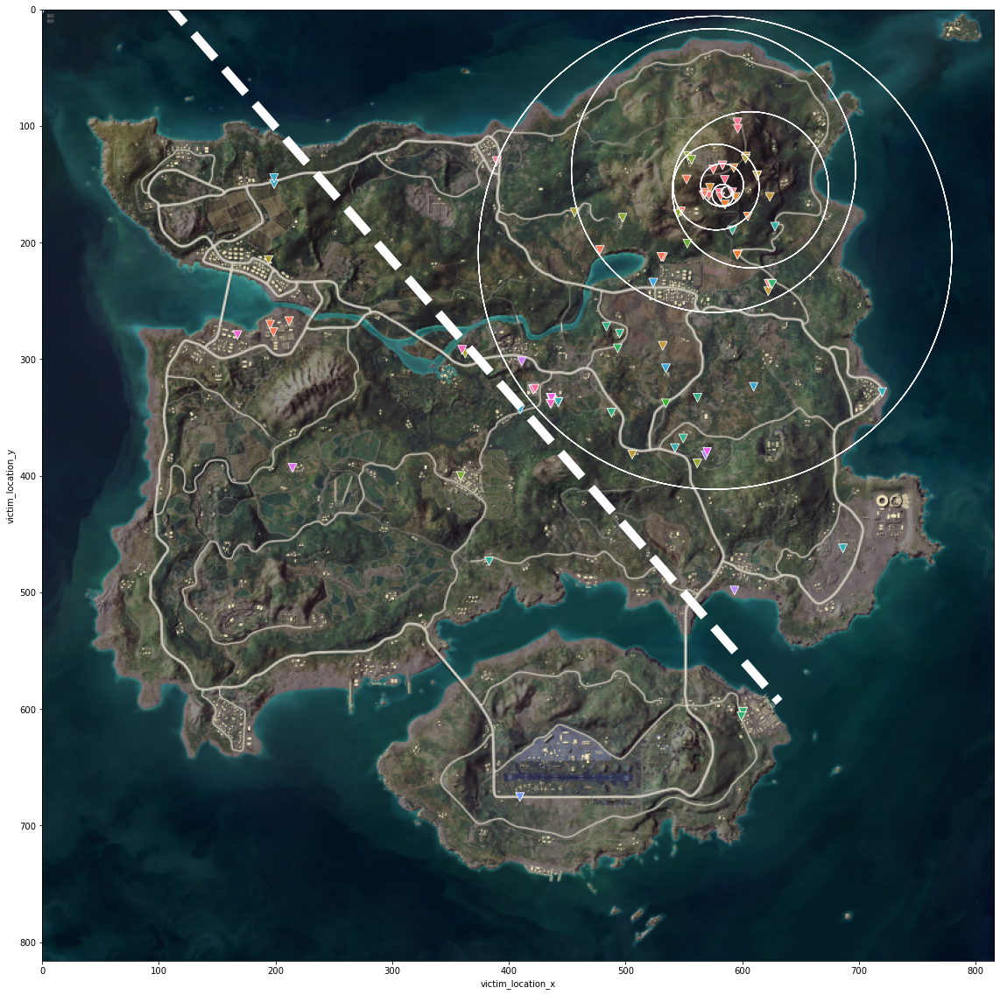

In [60]:
#looking at kills based on player, different colours for different players. The dotted white line is the flight path at the start of the match, the white circles are the restricting play area
#upward triangle are killer location, downward triangles are victim locations.

fig, ax = plt.subplots(figsize=(20,20))
im = plt.imread('/Users/tim/Desktop/GA/lessons/DSI16-lessons/project/project-capstone/My capstone/images/Erangel_Main_No_Text_Low_Res.png')
implot = plt.imshow(im)

first_flight = [example_match['first_flight_location_x'],example_match['first_flight_location_y']]
last_flight = [example_match['last_flight_location_x'],example_match['last_flight_location_y']]
x_values = [first_flight[0], last_flight[0]]
y_values = [first_flight[1], last_flight[1]]
plt.plot(x_values, y_values,color='white', linestyle='dashed',linewidth=10)

for i in [x[:6] for x in example_match.columns if 'GS_' in x]:
    x=example_match[i+'_poisonGasWarningPosition_x']
    y=example_match[i+'_poisonGasWarningPosition_y']
#    ax.scatter(x=x,y=y)
    plt.xlim([0,816])
    plt.ylim([0,816])
    cir=plt.Circle((x,y),(float(example_match[i+'_poisonGasWarningRadius'])/1000),fill=False,color='w')
    ax.add_patch(cir)
    plt.gca().invert_yaxis()


sns.scatterplot(data=mini_death_df,x='victim_location_x',y='victim_location_y',hue='finisher_accountId',s=100,marker='v',legend=None)
    
plt.show()

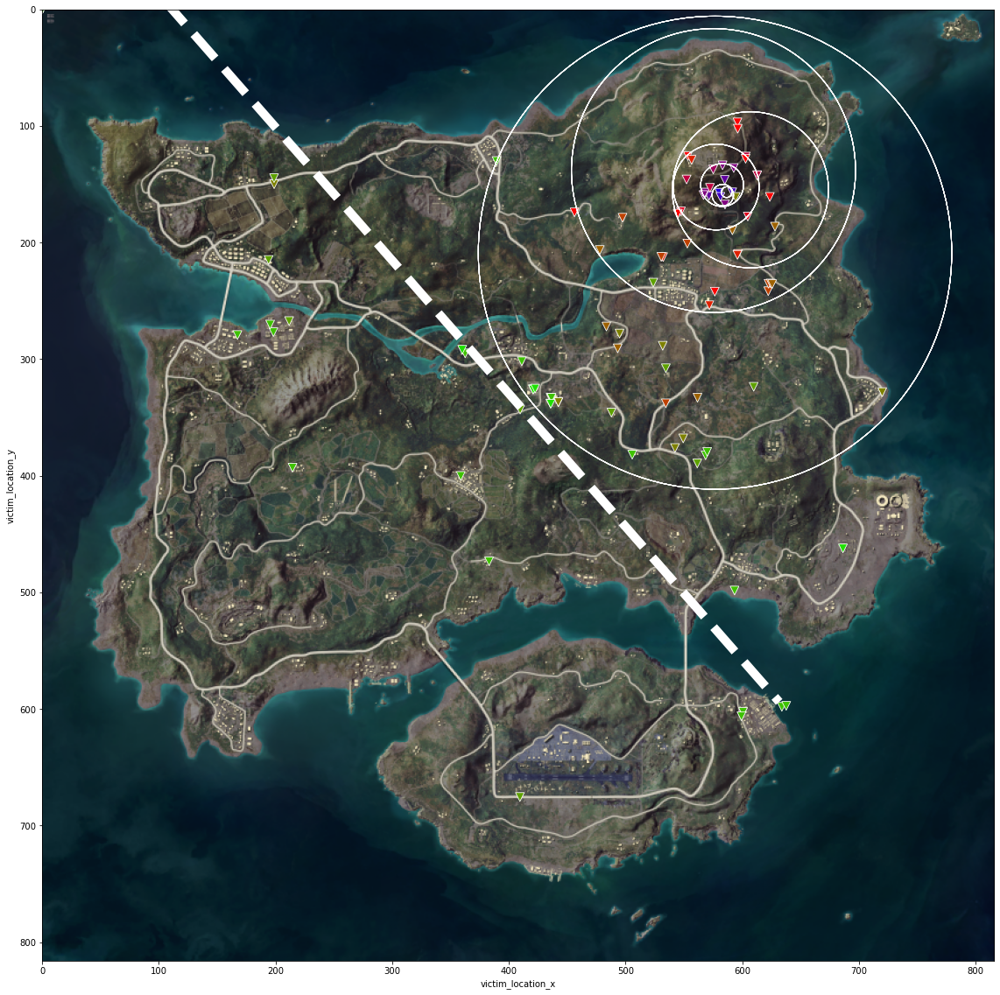

In [93]:
#looking at kills per gamestate. The dotted white line is the flight path at the start of the match, the white circles are the restricting play area
#downward triangles are victim locations. Can add killer locations by unhashing the code.

import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(20,20))
im = plt.imread('/Users/tim/Desktop/GA/lessons/DSI16-lessons/project/project-capstone/My capstone/images/Erangel_Main_No_Text_Low_Res.png')
implot = plt.imshow(im)

first_flight = [example_match['first_flight_location_x'],example_match['first_flight_location_y']]
last_flight = [example_match['last_flight_location_x'],example_match['last_flight_location_y']]
x_values = [first_flight[0], last_flight[0]]
y_values = [first_flight[1], last_flight[1]]
plt.plot(x_values, y_values,color='white', linestyle='dashed',linewidth=10)

for i in [x[:6] for x in example_match.columns if 'GS_' in x]:
    x=example_match[i+'_poisonGasWarningPosition_x']
    y=example_match[i+'_poisonGasWarningPosition_y']
# #    ax.scatter(x=x,y=y)
    plt.xlim([0,816])
    plt.ylim([0,816])
    cir=plt.Circle((x,y),(float(example_match[i+'_poisonGasWarningRadius'])/1000),fill=False,color='w')
    ax.add_patch(cir)
    plt.gca().invert_yaxis()


sns.scatterplot(data=mini_death_df,x='victim_location_x',y='victim_location_y',hue='gameState',s=100,palette='brg',marker='v',legend=None)
# sns.scatterplot(data=mini_death_df,x='finisher_location_x',y='finisher_location_y',hue='gameState',s=100,palette='brg',marker='^')
    
plt.show()

#### Here we are looking at flight paths and play area distribution. There are a lot of options, and these are largely random. It makes it difficult to compare matches against one another because the sample size reduces so quickly when trying to compare similiar matches.

In [100]:
#adding x and y coordinates for each circle across the whole dataframe.
for i in baltic_df[[x for x in baltic_df.columns if 'WarningPosition' in x]]:
    baltic_df[i+'_x'] = baltic_df[i].apply(location_stripper_x)
    baltic_df[i+'_y'] = baltic_df[i].apply(location_stripper_y_baltic)

<ipython-input-100-9fd2bcb25cae>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_df[i+'_x'] = baltic_df[i].apply(location_stripper_x)
<ipython-input-100-9fd2bcb25cae>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_df[i+'_y'] = baltic_df[i].apply(location_stripper_y_baltic)


In [172]:
for i in baltic_df[[x for x in df.columns if 'flight_location' in x]]:
    baltic_df[i+'_x'] = baltic_df[i].apply(location_stripper_x)
    baltic_df[i+'_y'] = baltic_df[i].apply(location_stripper_y_baltic)

<ipython-input-172-d8afd8d568a7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_df[i+'_x'] = baltic_df[i].apply(location_stripper_x)
<ipython-input-172-d8afd8d568a7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  baltic_df[i+'_y'] = baltic_df[i].apply(location_stripper_y_baltic)


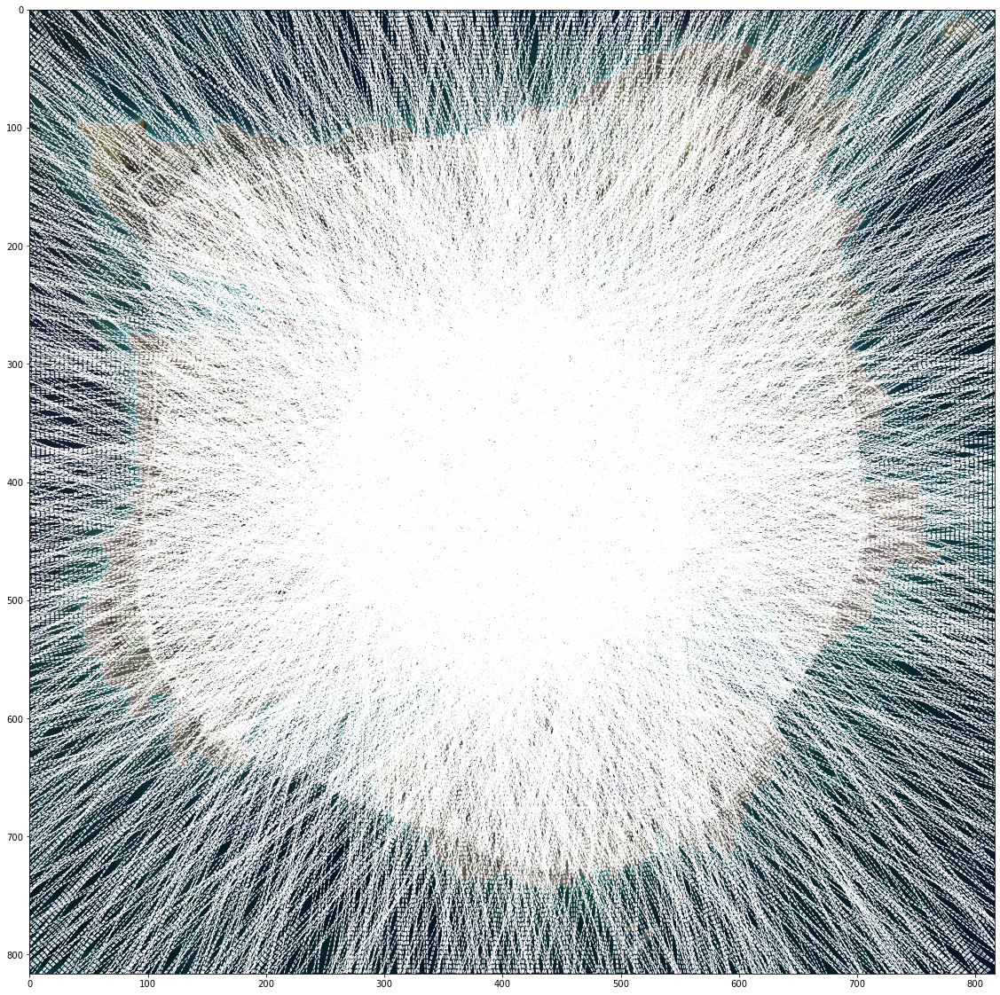

In [192]:
fig, ax = plt.subplots(figsize=(20,20))
im = plt.imread('/Users/tim/Desktop/GA/lessons/DSI16-lessons/project/project-capstone/My capstone/images/Erangel_Main_No_Text_Low_Res.png')
implot = plt.imshow(im)
for i in range(len(baltic_df[:3000])):
    first_flight = [baltic_df.iloc[i]['first_flight_location_x'],baltic_df.iloc[i]['first_flight_location_y']]
    last_flight = [baltic_df.iloc[i]['last_flight_location_x'],baltic_df.iloc[i]['last_flight_location_y']]
    x_values = [first_flight[0], last_flight[0]]
    y_values = [first_flight[1], last_flight[1]]
    plt.plot(x_values, y_values,color='white', linestyle='dashed',linewidth=1)
    
plt.xlim([0,816])
plt.ylim([0,816])
plt.gca().invert_yaxis()
plt.show()

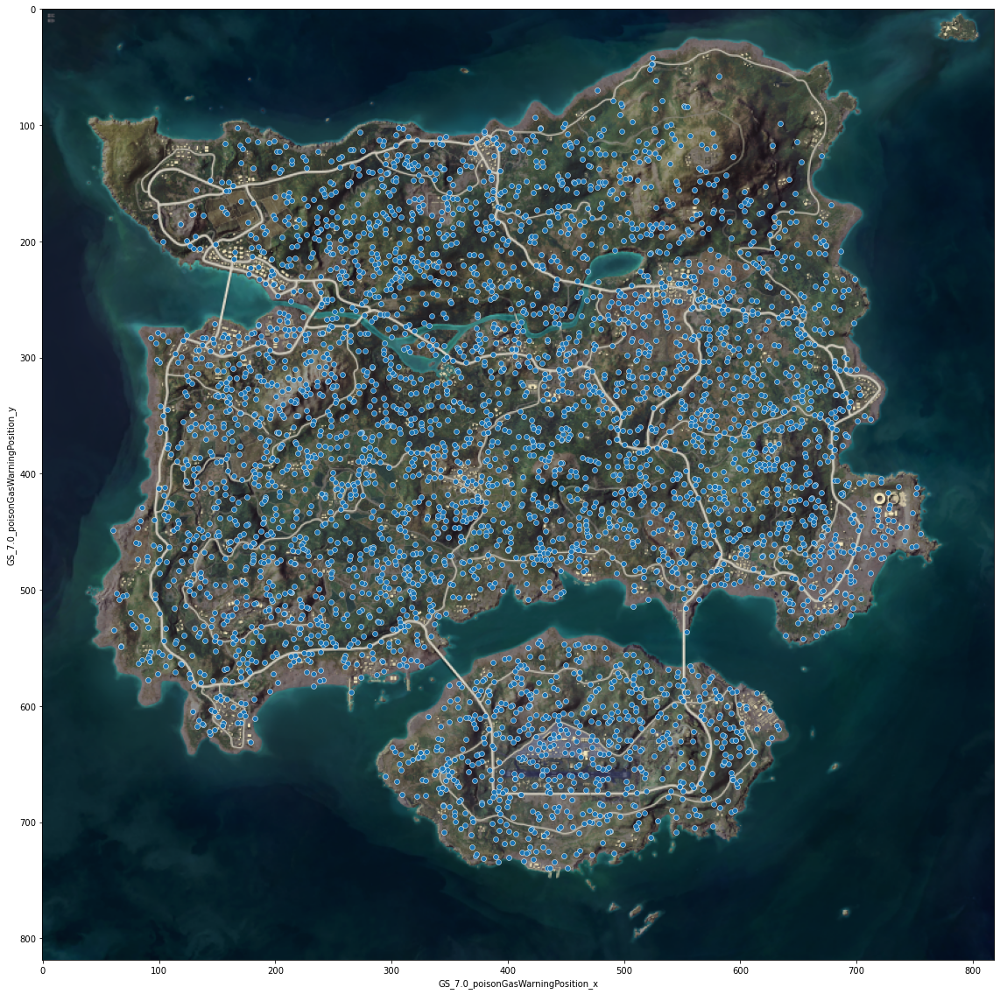

In [142]:
#here we are looking at the center of gamestate 7 play areas across all matches.

fig, ax = plt.subplots(figsize=(20,20))
im = plt.imread('/Users/tim/Desktop/GA/lessons/DSI16-lessons/project/project-capstone/My capstone/images/Erangel_Main_No_Text_Low_Res.png')
implot = plt.imshow(im)

sns.scatterplot(data=baltic_df,x='GS_7.0_poisonGasWarningPosition_x',y='GS_7.0_poisonGasWarningPosition_y',legend=None,palette='#00cfcc')


/Users/tim/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2163: UserWarning: `displot` is a figure-level function and does not accept the ax= paramter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


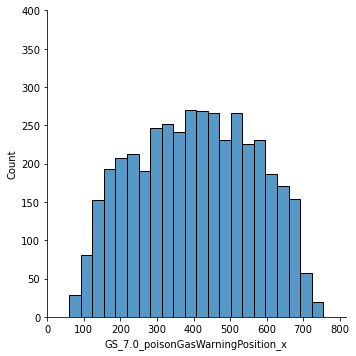

/Users/tim/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2163: UserWarning: `displot` is a figure-level function and does not accept the ax= paramter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


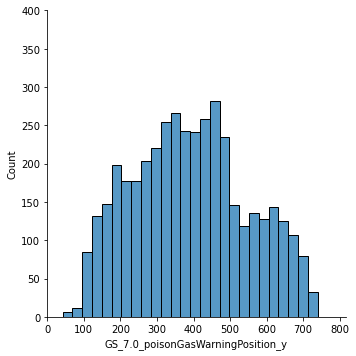

In [171]:
# There doesn't appear to be much of a pattern. The center of the play area is never in water, aisde from that, these points can be anywhere.

sns.displot(data=baltic_df,x='GS_7.0_poisonGasWarningPosition_x', ax=ax)
plt.xlim([0,816])
plt.ylim([0,400])
plt.show()

sns.displot(data=baltic_df,x='GS_7.0_poisonGasWarningPosition_y', ax=ax)
plt.xlim([0,816])
plt.ylim([0,400])
plt.show()

## Making a full death dataframe

#### Because of the random nature of the flight path and playzone elements, I decided to make a dataframe of all deaths and explore that.

In [68]:
#Making a new dataframe from the deaths in the row of this match.


big_temp_list = []

for j in baltic_df.index:    
    for i in range(100):
        temp_list = []
        
        temp_list.append(baltic_df['gameMode'][j])
        temp_list.append(baltic_df['mapName'][j])
        temp_list.append(baltic_df['duration'][j])
        temp_list.append(baltic_df['matchId'][j])        
        temp_list.append(baltic_df['GS_0.1_numStartPlayers'][j])
        
        for z in [x for x in baltic_df.columns if 'numAliveTeams' in x]:
            temp_list.append(baltic_df[z][j])
        
        for z in [x for x in baltic_df.columns if 'poisonGasWarningPosition' in x]:
            temp_list.append(baltic_df[z][j])
        

        temp_list.append(i)
        temp_list.append(baltic_df['death#'+str(i)+'_victim_accountId'][j])
        temp_list.append(location_stripper_x(baltic_df['death#'+str(i)+'_victim_location'][j]))
        temp_list.append(location_stripper_y_baltic(baltic_df['death#'+str(i)+'_victim_location'][j]))
        temp_list.append(baltic_df['death#'+str(i)+'_victim_ranking'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finisher_accountId'][j])
        temp_list.append(location_stripper_x(baltic_df['death#'+str(i)+'_finisher_location'][j]))
        temp_list.append(location_stripper_y_baltic(baltic_df['death#'+str(i)+'_finisher_location'][j]))
        temp_list.append(baltic_df['death#'+str(i)+'_finisher_health'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finisher_ranking'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finishDamageInfo_damageReason'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finishDamageInfo_damageTypeCategory'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finishDamageInfo_damageCauserName'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_finishDamageInfo_distance'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_isSuicide_'][j])
        temp_list.append(baltic_df['death#'+str(i)+'_common_'][j])
        temp_list.append(baltic_df['death#'+str(i)+'__D_'][j])
        big_temp_list.append(temp_list)
    
#making a list of column names
death_df_col_names = []

death_df_col_names.append('gameMode')
death_df_col_names.append('mapName')
death_df_col_names.append('duration')
death_df_col_names.append('matchId')
death_df_col_names.append('numStartPlayers')


for z in [x for x in baltic_df.columns if 'numAliveTeams' in x]:
    death_df_col_names.append(z)
for z in [x for x in baltic_df.columns if 'poisonGasWarningPosition' in x]:
    death_df_col_names.append(z)

death_df_col_names.append('death_#')
death_df_col_names.append('victim_accountId')
death_df_col_names.append('victim_location_x')
death_df_col_names.append('victim_location_y')
death_df_col_names.append('victim_ranking')
death_df_col_names.append('finisher_accountId')
death_df_col_names.append('finisher_location_x')
death_df_col_names.append('finisher_location_y')
death_df_col_names.append('finisher_health')
death_df_col_names.append('finisher_ranking')
death_df_col_names.append('finishDamageInfo_damageReason')
death_df_col_names.append('finishDamageInfo_damageTypeCategory')
death_df_col_names.append('finishDamageInfo_damageCauserName')
death_df_col_names.append('finishDamageInfo_distance')
death_df_col_names.append('isSuicide')
death_df_col_names.append('gameState')
death_df_col_names.append('timestamp')

death_df = pd.DataFrame(data=big_temp_list, columns=death_df_col_names)
death_df

,gameMode,mapName,duration,matchId,numStartPlayers,GS_0.1_numAliveTeams,GS_1.0_numAliveTeams,GS_1.5_numAliveTeams,GS_2.0_numAliveTeams,GS_2.5_numAliveTeams,GS_3.0_numAliveTeams,GS_3.5_numAliveTeams,GS_4.0_numAliveTeams,GS_4.5_numAliveTeams,GS_5.0_numAliveTeams,GS_5.5_numAliveTeams,GS_6.0_numAliveTeams,GS_6.5_numAliveTeams,GS_7.0_numAliveTeams,GS_7.5_numAliveTeams,GS_8.0_numAliveTeams,GS_8.5_numAliveTeams,GS_9.0_numAliveTeams,GS_9.5_numAliveTeams,GS_10._numAliveTeams,GS_0.1_poisonGasWarningPosition,GS_1.0_poisonGasWarningPosition,GS_1.5_poisonGasWarningPosition,GS_2.0_poisonGasWarningPosition,GS_2.5_poisonGasWarningPosition,GS_3.0_poisonGasWarningPosition,GS_3.5_poisonGasWarningPosition,GS_4.0_poisonGasWarningPosition,GS_4.5_poisonGasWarningPosition,GS_5.0_poisonGasWarningPosition,GS_5.5_poisonGasWarningPosition,GS_6.0_poisonGasWarningPosition,GS_6.5_poisonGasWarningPosition,GS_7.0_poisonGasWarningPosition,GS_7.5_poisonGasWarningPosition,GS_8.0_poisonGasWarningPosition,GS_8.5_poisonGasWarningPosition,GS_9.0_poisonGasWarningPosition,GS_9.5_poisonGasWarningPosition,GS_10._poisonGasWarningPosition,death_#,victim_accountId,victim_location_x,victim_location_y,victim_ranking,finisher_accountId,finisher_location_x,finisher_location_y,finisher_health,finisher_ranking,finishDamageInfo_damageReason,finishDamageInfo_damageTypeCategory,finishDamageInfo_damageCauserName,finishDamageInfo_distance,isSuicide,gameState,timestamp
0,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}",NaN,NaN,NaN,NaN,NaN,0,account.ac032d51cd9c47b482dadf4858b7686a,580.263625,157.275750,2.0,account.d25a7c228fb94024813f909f4892ba4f,582.567188,157.548234,100.000000,0.0,TorsoShot,Damage_Gun,WeapHK416_C,2321.666748,False,{'isGame': 7.5},2021-04-08T00:45:03.615Z
1,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}",NaN,NaN,NaN,NaN,NaN,1,account.c342c360c6bb4756bd8e930be503a201,581.282125,160.841750,3.0,account.ac032d51cd9c47b482dadf4858b7686a,580.682250,159.945844,44.399998,0.0,TorsoShot,Damage_Gun,WeapGroza_C,1098.807617,False,{'isGame': 7},2021-04-08T00:44:30.678Z
2,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z

In [78]:
def gameState_stripper(gameState):
    if type(gameState) == float:
        return gameState
    else:
        return gameState.split(':')[1].strip()[:-1]

In [79]:
death_df['gameState'] = death_df['gameState'].apply(gameState_stripper)

In [293]:
death_df

,gameMode,mapName,duration,matchId,numStartPlayers,GS_0.1_numAliveTeams,GS_1.0_numAliveTeams,GS_1.5_numAliveTeams,GS_2.0_numAliveTeams,GS_2.5_numAliveTeams,GS_3.0_numAliveTeams,GS_3.5_numAliveTeams,GS_4.0_numAliveTeams,GS_4.5_numAliveTeams,GS_5.0_numAliveTeams,GS_5.5_numAliveTeams,GS_6.0_numAliveTeams,GS_6.5_numAliveTeams,GS_7.0_numAliveTeams,GS_7.5_numAliveTeams,GS_8.0_numAliveTeams,GS_8.5_numAliveTeams,GS_9.0_numAliveTeams,GS_9.5_numAliveTeams,GS_10._numAliveTeams,GS_0.1_poisonGasWarningPosition,GS_1.0_poisonGasWarningPosition,GS_1.5_poisonGasWarningPosition,GS_2.0_poisonGasWarningPosition,GS_2.5_poisonGasWarningPosition,GS_3.0_poisonGasWarningPosition,GS_3.5_poisonGasWarningPosition,GS_4.0_poisonGasWarningPosition,GS_4.5_poisonGasWarningPosition,GS_5.0_poisonGasWarningPosition,GS_5.5_poisonGasWarningPosition,GS_6.0_poisonGasWarningPosition,GS_6.5_poisonGasWarningPosition,GS_7.0_poisonGasWarningPosition,GS_7.5_poisonGasWarningPosition,GS_8.0_poisonGasWarningPosition,GS_8.5_poisonGasWarningPosition,GS_9.0_poisonGasWarningPosition,GS_9.5_poisonGasWarningPosition,GS_10._poisonGasWarningPosition,death_#,victim_accountId,victim_location_x,victim_location_y,victim_ranking,finisher_accountId,finisher_location_x,finisher_location_y,finisher_health,finisher_ranking,finishDamageInfo_damageReason,finishDamageInfo_damageTypeCategory,finishDamageInfo_damageCauserName,finishDamageInfo_distance,isSuicide,gameState,timestamp,gamestage
0,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}",NaN,NaN,NaN,NaN,NaN,0,account.ac032d51cd9c47b482dadf4858b7686a,580.263625,157.275750,2.0,account.d25a7c228fb94024813f909f4892ba4f,582.567188,157.548234,100.000000,0.0,TorsoShot,Damage_Gun,WeapHK416_C,2321.666748,False,7.5,2021-04-08T00:45:03.615Z,late
1,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 606991.125, 'y': 154758.28125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 577635.75, 'y': 152369.8125, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 582748.5625, 'y': 150666.109375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 583322.125, 'y': 159293.09375, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}","{'x': 586597.5625, 'y': 156779.75, 'z': 0}",NaN,NaN,NaN,NaN,NaN,1,account.c342c360c6bb4756bd8e930be503a201,581.282125,160.841750,3.0,account.ac032d51cd9c47b482dadf4858b7686a,580.682250,159.945844,44.399998,0.0,TorsoShot,Damage_Gun,WeapGroza_C,1098.807617,False,7,2021-04-08T00:44:30.678Z,late
2,solo,Baltic_Main,1754,7373654d-5bc9-4ce4-92e3-963377f9b079,97.0,97.0,91.0,71.0,57.0,46.0,40.0,32.0,28.0,19.0,17.0,12.0,10.0,5.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,"{'x': 0, 'y': 0, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 576688.875, 'y': 208690.96875, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0}","{'x': 575342.625, 'y': 138220.828125, 'z': 0

In [301]:
def what_game_stage(gameState):
    if float(gameState) < 2:
        return 'early'
    if float(gameState) <= 6:
        return 'mid'
    if float(gameState) > 6:
        return 'late'
    
def gamestate2(gameState):
    if gameState == 0.10000000149011612:
        return 0.1
    else:
        return gameState

In [298]:
death_df['gameState2'] = death_df['gameState'].apply(lambda x: float(x))

In [302]:
death_df['gameState2'] = death_df['gameState2'].apply(gamestate2)

In [288]:
death_df['gamestage'] = death_df['gameState'].apply(what_game_stage)

#### We can see the distance between killer and victim and how the changes over the gamestates. At the start of a match, people are in close quarters looking for equipment, in the middle of the game players are more spreadout, and by the end of the match the play area is pushing lpayers together again.

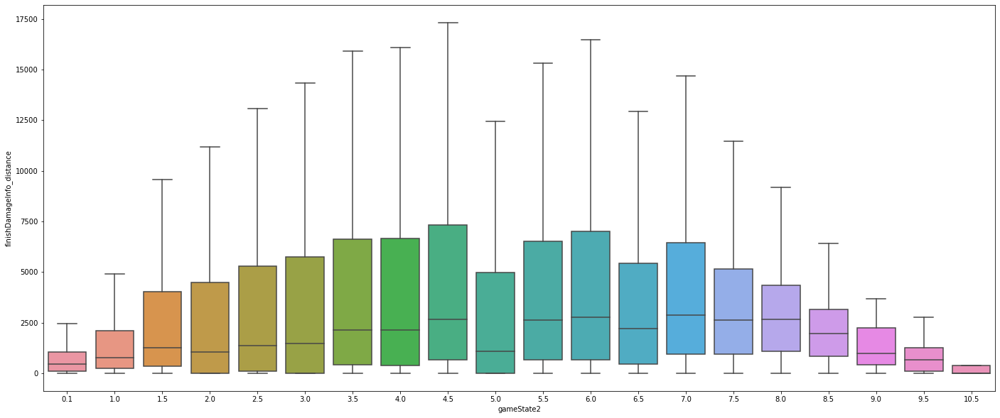

In [307]:
fig, ax = plt.subplots(figsize=(24,10))
sns.boxplot(data = death_df, y = 'finishDamageInfo_distance', x='gameState2', orient = 'v',showfliers = False)
plt.savefig('/Users/tim/Desktop/Capstone images/distance_vs_gamestate.png')
plt.show()

In [229]:
def damage_causer_cat(damage_type):
    assault_rifles = ['WeapHK416_C','WeapGroza_C', 'WeapMk47Mutant_C','WeapAK47_C', 'WeapBerylM762_C', 'WeapSCAR-L_C', 'WeapAUG_C','WeapM16A4_C']
    lmg = ['WeapM249_C', 'WeapDP28_C', 'WeapMG3_C']
    thrown_projectile = ['ProjGrenade_C','ProjC4_C','ProjMolotov_C','BP_JerryCan_Projectile_Spill_C', 'BP_FireEffectController_C','BP_MolotovFireDebuff_C','BP_JerryCan_Projectile_Discard_C','DroppedItemGroup','BP_JerryCan_FuelPuddle_C','BP_FireEffectController_JerryCan_C', 'BP_JerryCanFireDebuff_C','DroppedItem']
    ai_implosion = ['SimulateAIBeKilled']
    crossbow = ['WeapCrossbow_1_C']
    pistols = ['WeapM9_C', 'WeapM1911_C', 'WeapG18_C', 'WeapDesertEagle_C', 'Weapvz61Skorpion_C']
    shotguns =['WeapWinchester_C', 'WeapBerreta686_C', 'WeapSaiga12_C','WeapDP12_C']
    sub_machineguns = ['WeapVector_C','WeapUMP_C', 'WeapBizonPP19_C',  'WeapUZI_C','WeapThompson_C', 'WeapNagantM1895_C']
    sniper_dmr = ['WeapVSS_C', 'WeapFNFal_C','WeapMini14_C', 'WeapM24_C','WeapKar98k_C','WeapSKS_C','WeapMosinNagant_C','WeapMk14_C','WeapAWM_C']
    environment = ['BP_Eragel_CargoShip01_C','BattleRoyaleModeController_Def_C','RedZoneBombingField_Def_C','RedZoneBombingField']
    vehicle = ['BP_BRDM_C','Buggy_A_02_C','BP_CoupeRB_C','AquaRail_A_01_C', 'BP_Motorbike_04_C', 'BP_Dirtbike_C', 'Buggy_A_01_C','Uaz_A_01_C','Uaz_C_01_C', 'Uaz_B_01_C','BP_Motorbike_04_SideCar_C', 'Buggy_A_03_C','Dacia_A_02_v2_C', 'Dacia_A_04_v2_C', 'Dacia_A_03_v2_C','Dacia_A_01_v2_C','Boat_PG117_C','BP_Motorglider_C']
    misc = ['Buff_DecreaseBreathInApnea_C', 'AIPawn_Base_Male_C','None','AIPawn_Base_Female_C']
    thrown_melee_weapon = ['WeapPanProjectile_C','WeapMacheteProjectile_C','WeapCowbarProjectile_C','WeapSickleProjectile_C']
    melee = ['PlayerMale_A_C','WeapPan_C','WeapSickle_C', 'PlayerFemale_A_C', 'WeapMachete_C', 'WeapCowbar_C']
    
    try:
        if damage_type.isna():
            return damage_type
    except:
        pass
    
    if damage_type in assault_rifles:
        return 'assault_rifle'
    if damage_type in lmg:
        return 'lmg'
    if damage_type in thrown_projectile:
        return 'thrown_projectile'
    if damage_type in ai_implosion:
        return 'SimulateAIBeKilled'
    if damage_type in crossbow:
        return 'crossbow'
    if damage_type in pistols:
        return 'pistol'
    if damage_type in shotguns:
        return 'shotgun'
    if damage_type in sub_machineguns:
        return 'sub_machinegun'
    if damage_type in sniper_dmr:
        return 'sniper_dmr'
    if damage_type in environment:
        return 'environment'
    if damage_type in vehicle:
        return 'vehicle'
    if damage_type in misc:
        return 'misc'
    if damage_type in thrown_melee_weapon:
        return 'thrown_melee_weapon'
    if damage_type in melee:
        return 'melee'
